<a href="https://colab.research.google.com/github/vincentbriat/Super-resolution-investigation/blob/main/Individual_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Handles all the necesary imports and connects to my Google Drive

In [1]:
from os import listdir, environ, path
import sys
from pathlib import Path
import pandas as pd
from PIL import Image
import torch
from torch import nn
from torch.nn import functional as F
import torchvision
import cv2 as cv 
from sklearn.decomposition import PCA
import numpy as np
from google.colab import drive
import random as rd
import csv
from torchsummary import summary
import matplotlib.pyplot as plt

!pip install pytorch-msssim
from pytorch_msssim import ssim, ms_ssim, SSIM, MS_SSIM

drive.mount('/content/drive/')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Mounted at /content/drive/


In [2]:
# Making sure to use the gpu, if available
device = 'cuda' if torch.cuda.is_available() else 'cpu'
# torch.cuda.set_device(torch.device(0))

load images

In [3]:
# !unzip /content/drive/MyDrive/Datasets/DIV2K_train_LR_mild_REAL_ESRGAN_output.zip
# !unzip /content/drive/MyDrive/Datasets/DIV2K_valid_LR_mild_REAL_ESRGAN_output.zip
# !unzip /content/drive/MyDrive/Datasets/DIV2K_train_LR_mild.zip
# !unzip /content/drive/MyDrive/Datasets/DIV2K_valid_LR_mild.zip
# !unzip /content/drive/MyDrive/Datasets/DIV2K_train_LR_clean_REAL_ESRGAN_output.zip
# !unzip /content/drive/MyDrive/Datasets/DIV2K_valid_LR_clean_REAL_ESRGAN_output.zip
!unzip /content/drive/MyDrive/Datasets/DIV2K_train_LR_clean.zip
!unzip /content/drive/MyDrive/Datasets/DIV2K_valid_LR_clean.zip
# !unzip /content/drive/MyDrive/Datasets/DIV2K_train_HR.zip
# !unzip /content/drive/MyDrive/Datasets/DIV2K_valid_HR.zip

# !unzip /content/drive/MyDrive/Datasets/DIV2K_valid_LR_difficult.zip
# !unzip /content/drive/MyDrive/Datasets/DIV2K_valid_LR_difficult_REAL_ESRGAN_output.zip


Archive:  /content/drive/MyDrive/Datasets/DIV2K_train_LR_clean.zip
   creating: DIV2K_train_LR_clean/
 extracting: DIV2K_train_LR_clean/0001.png  
 extracting: DIV2K_train_LR_clean/0002.png  
 extracting: DIV2K_train_LR_clean/0003.png  
 extracting: DIV2K_train_LR_clean/0004.png  
  inflating: DIV2K_train_LR_clean/0005.png  
 extracting: DIV2K_train_LR_clean/0006.png  
 extracting: DIV2K_train_LR_clean/0007.png  
 extracting: DIV2K_train_LR_clean/0008.png  
 extracting: DIV2K_train_LR_clean/0009.png  
 extracting: DIV2K_train_LR_clean/0010.png  
 extracting: DIV2K_train_LR_clean/0011.png  
 extracting: DIV2K_train_LR_clean/0012.png  
 extracting: DIV2K_train_LR_clean/0013.png  
  inflating: DIV2K_train_LR_clean/0014.png  
 extracting: DIV2K_train_LR_clean/0015.png  
 extracting: DIV2K_train_LR_clean/0016.png  
  inflating: DIV2K_train_LR_clean/0017.png  
 extracting: DIV2K_train_LR_clean/0018.png  
 extracting: DIV2K_train_LR_clean/0019.png  
 extracting: DIV2K_train_LR_clean/0020.png 

# Non-machine learning methods

We begin with using a basic upscaling method provided by the PIL library.

We will try nearest-neighbour, bilinear and bicubic interpolations.

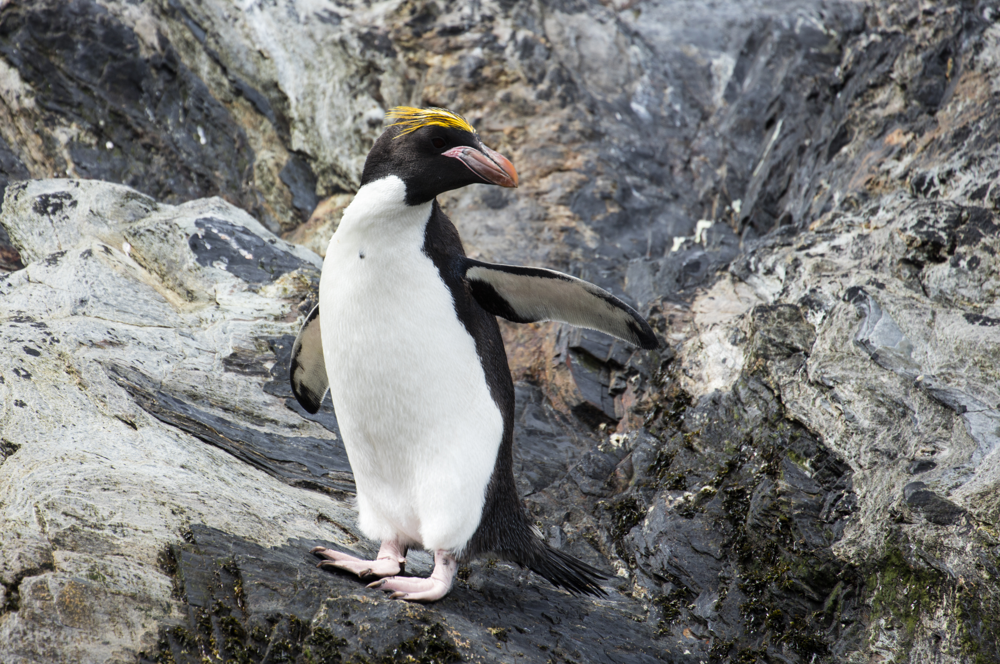

In [ ]:
high_res_image = Image.open('DIV2K_valid_HR/0801.png')
high_res_image

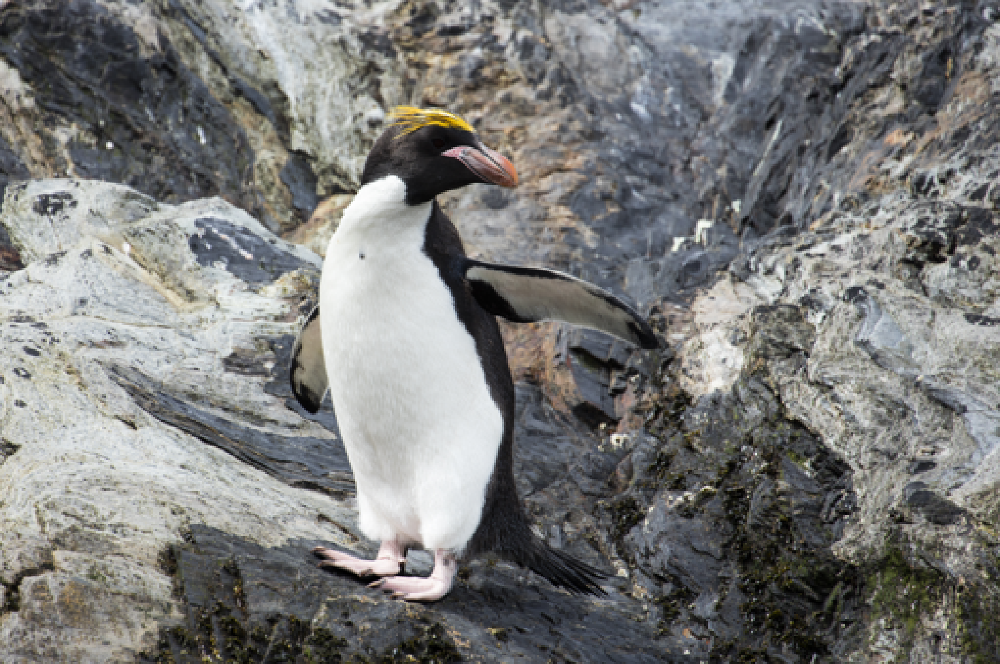

In [ ]:
low_res_image = high_res_image.resize((510,384)).resize(high_res_image.size, 0)
low_res_image

This image is **pixelated** which is a direct result of the nearest meighbourg method

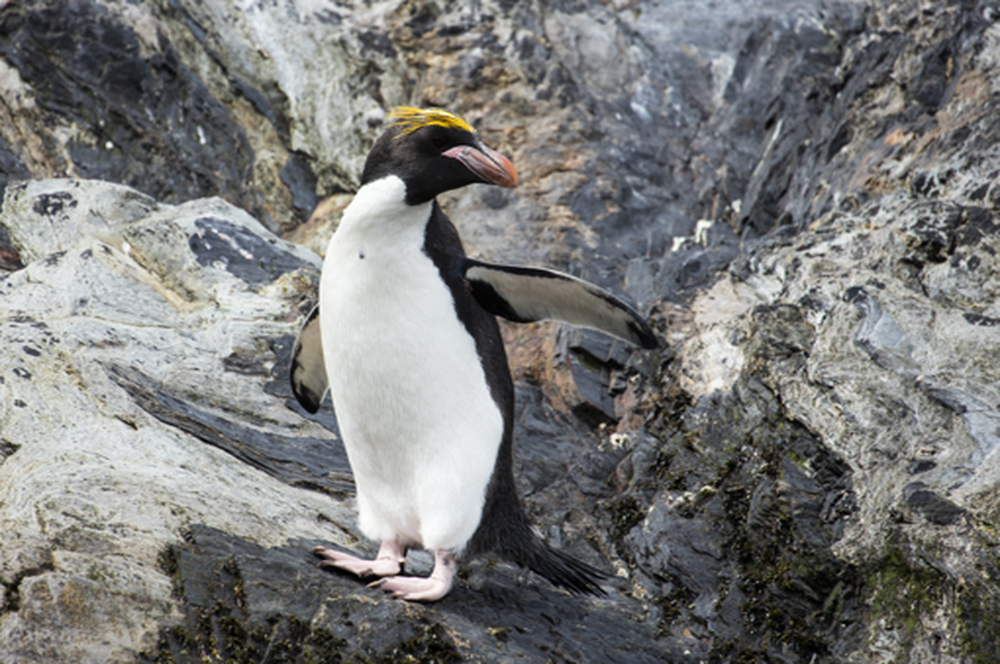

In [ ]:
low_res_image = high_res_image.resize((510,384)).resize(high_res_image.size, 1)
low_res_image

This image has lost the pixelated effect with **interpolation**. However, **linear interpolation** doesn't have a strong impact on the noise.

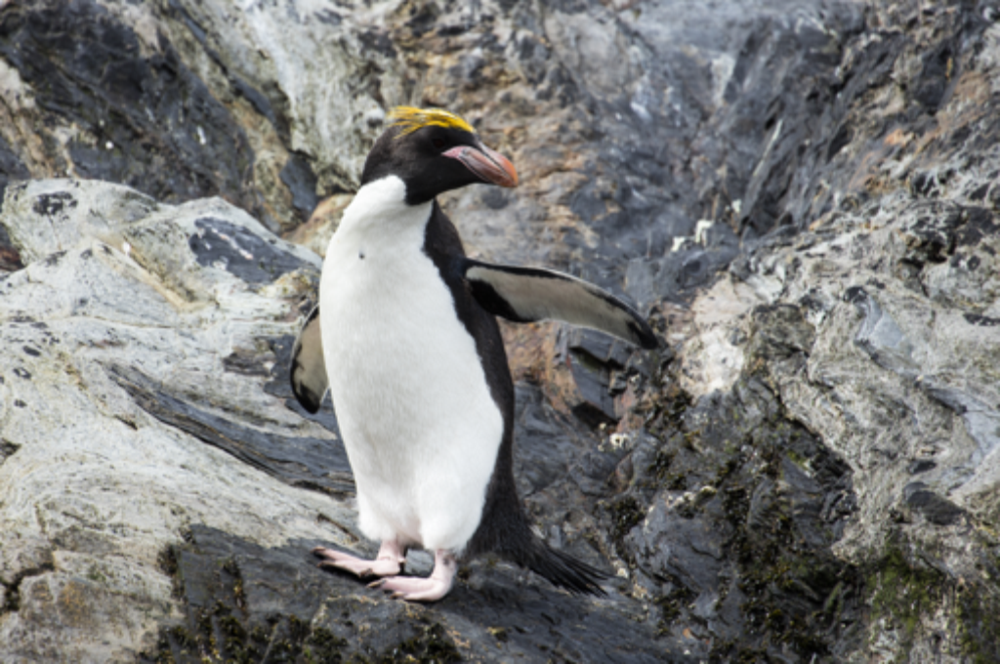

In [ ]:
low_res_image = high_res_image.resize((510,340)).resize((1024,680), 2)
low_res_image

Bicubic interpolation seems to have slightly impacted the noise, which is a very important part of the image quality nonetheless.

# Setup the classes for neural networks

Let's create a class to get the input and target images from the different folders

In [32]:
class DIV2KLoader(object):
  def __init__(self, low_res_folder, high_res_folder = None, preprocessing_input = None, preprocessing_output = None, include_targets = True):
    self.low_res_folder = low_res_folder
    self.high_res_folder = high_res_folder
    self.img_names = sorted(listdir(low_res_folder))
    self.include_targets = include_targets
    self.len = len(self.img_names)
    
    if include_targets or high_res_folder is not None:
      self.target_names = sorted(listdir(high_res_folder))

    if preprocessing_input is None:
      self.preprocessing_input = torchvision.transforms.ToTensor()
    else:
      self.preprocessing_input = preprocessing_input

    if preprocessing_output is None:
      self.preprocessing_output = torchvision.transforms.ToTensor()
    else:
      self.preprocessing_output = preprocessing_output
  
  def __getitem__(self, i):
    # Get the right image
    img = Image.open(Path(self.low_res_folder).joinpath(self.img_names[i]))
    if self.include_targets or self.high_res_folder is not None:
      target = Image.open(Path(self.high_res_folder).joinpath(self.target_names[i]))
      return self.preprocessing_input(img), self.preprocessing_output(target)
    else:
      return self.preprocessing_input(img)

  def __len__(self):
    return self.len
  
  def restrict_size(self, size):
    if size < len(self.img_names) and size > 0:
      self.len = size
    else:
      self.len = len(self.img_names)
      print(f"Size must be between 0 and {len(self.img_names)}")

In [43]:
class NeuralNetwork(nn.Module):
    def __init__(self):
        super().__init__()
        learning_rate = 1e-1

        self.model = nn.Sequential(nn.Linear(1,1))
        self.cur_epoch = 0

    def forward(self, x):
        return self.model(x)
    
    def initialize_csv(self, path, dataloader_test):
      loss = self.test(dataloader_test)
      self.record(path, ['epoch', 'loss'])
      self.record(path, [self.cur_epoch, loss])

    def record(self, path, row):
      with open(path, 'a', newline='') as f:
        csv.writer(f).writerow(row)
      print("Recorded Successfully!")

    def train_one_batch(self, X, y):
      super().train()
      pred = self(X)
      loss = self.loss_fn(pred, y)

      # Backpropagation
      self.opt.zero_grad()
      loss.backward()
      self.opt.step()
      return loss

    def train_one_epoch(self, dataloader):
      super().train()
      total_loss = 0
      for batch, (X, y) in enumerate(dataloader):
            # Compute prediction and loss

            loss = self.train_one_batch(X,y)
            total_loss += loss

            loss, current = loss.item(), batch * len(X)
            print(f"loss: {loss:>7f}  [{current:>5d}/{len(dataloader.dataset):>5d}]")

      self.scheduler.step()
      return total_loss.item()/len(dataloader)

    def test(self, dataloader):
      self.eval()
      test_loss = 0
      
      with torch.no_grad():
            for X, y in dataloader:

              pred = self(X)
              test_loss += self.loss_fn(pred, y)

      test_loss /= len(dataloader)
      print(f"Avg loss: {test_loss:>8f} \n")
      return test_loss.item()

    def exec_training(self, dataloader, dataloader_test, epochs, path_to_model=None, path_to_table = None):
      while self.cur_epoch < epochs:
        print(f"Epoch {self.cur_epoch+1}\n-------------------------------")
        temp_loss = 0
        temp_loss += self.train_one_epoch(dataloader)
        if dataloader_test is None:
          loss = temp_loss
          print(f"Avg loss: {loss:>8f}")
        else:
          loss = self.test(dataloader_test)

        if path_to_model is not None:
          self.save(path_to_model)
        if path_to_table is not None:
          self.record(path_to_table, [self.cur_epoch+1,loss])
        print("\n")
        self.cur_epoch += 1

In [34]:
class SSIM_loss(SSIM):
    def __init__(
        self,
        data_range=255,
        size_average=True,
        win_size=11,
        win_sigma=1.5,
        channel=3,
        spatial_dims=2,
        K=(0.01, 0.03),
        nonnegative_ssim=False,
    ):
        r""" class for ssim
        Args:
            data_range (float or int, optional): value range of input images. (usually 1.0 or 255)
            size_average (bool, optional): if size_average=True, ssim of all images will be averaged as a scalar
            win_size: (int, optional): the size of gauss kernel
            win_sigma: (float, optional): sigma of normal distribution
            channel (int, optional): input channels (default: 3)
            K (list or tuple, optional): scalar constants (K1, K2). Try a larger K2 constant (e.g. 0.4) if you get a negative or NaN results.
            nonnegative_ssim (bool, optional): force the ssim response to be nonnegative with relu.
        """

        super().__init__(
          data_range,
          size_average,
          win_size,
          win_sigma,
          channel,
          spatial_dims,
          K,
          nonnegative_ssim)

    def forward(self, X, Y):
        return 1-super().forward(X,Y)

# Dense neural networks

We can then implement and train a neural network with 3 hidden layers with low resolution images as input and high resolution images as targets.

Let's now build the model and create the functions to train and test the model

In [ ]:
class DenseNN(NeuralNetwork):
    def __init__(self, nb_components):
        super().__init__()
        self.nb_components = nb_components
        learning_rate = 1e-1

        self.flatten = nn.Flatten()
        self.model = nn.Sequential(
            nn.Linear(self.nb_components * 3072, 512),
            nn.ReLU(),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, self.nb_components * 3072),
        )
        self.opt = torch.optim.SGD(self.parameters(), lr=learning_rate, momentum = .9)
        self.scheduler = torch.optim.lr_scheduler.ExponentialLR(self.opt, gamma=0.9)
        self.loss_fn = nn.MSELoss()

    def forward(self, x):
        x = self.flatten(x)
        return super().forward(x)

    def load(self, path):
      saved_info = torch.load(path)
      self.opt.load_state_dict(saved_info['optimizer_state_dict'])
      self.load_state_dict(saved_info['model_state_dict'])
      self.scheduler.load_state_dict(saved_info['lr_scheduler_state_dict'])
      self.cur_epoch = saved_info['epochs'] + 1
      self.loss_fn = saved_info['loss_fn']

    def save(self,path):
      torch.save({'epochs': self.cur_epoch, 'model_state_dict': self.state_dict(), 'optimizer_state_dict': self.opt.state_dict(), 'loss_fn': self.loss_fn, 'lr_scheduler_state_dict': self.scheduler.state_dict()},path)

    def train_one_epoch(self, dataloader):
      self.train()
      for batch, (X, y) in enumerate(dataloader):
            # Compute prediction and loss

            X_sub,y_sub = applyPCAOnBatch(X,y, self.nb_components)
            pred = self(X_sub)
            y_sub = self.flatten(y_sub)
            loss = self.loss_fn(pred, y_sub)

            # Backpropagation
            self.opt.zero_grad()
            loss.backward()
            self.opt.step()


            if batch % 5 == 0:
                loss, current = loss.item(), batch * len(X)
                print(f"loss: {loss:>7f}  [{current:>5d}/{len(dataloader.dataset):>5d}]")
      self.scheduler.step()

    def test(self, dataloader):
      self.train()
      test_loss = 0;
      
      with torch.no_grad():
            for X, y in dataloader:
              X_sub,y_sub = applyPCAOnBatch(X,y, self.nb_components)

              pred = self(X_sub)
              y_sub = self.flatten(y_sub)
              test_loss += self.loss_fn(pred, y_sub)

      test_loss /= len(dataloader)
      print(f"Avg loss: {test_loss:>8f} \n")
      return test_loss.item()

    def infer(self, dataloader):
      self.eval()
      result = []
      for X, y in dataloader:
        X_sub, pcas = applyPCAOnBatchInference(y,self.nb_components)

        pred = self(X_sub)
        result += [torch.tensor(pcas[index].inverse_transform(pred[index].reshape(3,1024,self.nb_components))) for index in range(X_sub.shape[0])]
      return result

    def test_target(self, dataloader):
      result = []
      for X, y in dataloader:
        X_sub, y_sub, pcas = pca_test(X, y, self.nb_components)

        pred = y_sub
        result += [torch.tensor(pcas[index].inverse_transform(pred[index].reshape(3,1024,self.nb_components))) for index in range(X_sub.shape[0])]
      return result

# Applies PCA to a Tuple of tensors, returns 2 tensors and the PCA object
def applyPCA(X,y, n_components = 100):
  a,b,c = X.shape
  X = X.reshape((a*b,c))
  y = y.reshape((a*b,c))
  pca = PCA(n_components).fit(X)
  return torch.tensor(pca.transform(X)), torch.tensor(pca.transform(y)), pca

def applyPCAInference(X, n_components = 100):
  a,b,c = X.shape
  X = X.reshape((a*b,c))
  pca = PCA(n_components).fit(X)
  return torch.tensor(pca.transform(X)), pca

def applyPCAOnBatch(X,y, nb_components = 100):
  nb_batches = X.shape[0]
  X_temp = torch.zeros([nb_batches, X.shape[1]*X.shape[2],nb_components], dtype=X.dtype)
  y_temp = torch.zeros([nb_batches, y.shape[1]*y.shape[2],nb_components], dtype=y.dtype)
  for i in range(nb_batches):
    X_temp[i],y_temp[i],pca = applyPCA(X[i],y[i], nb_components)
  return X_temp,y_temp

def pca_test(X,y, nb_components = 100):
  nb_batches = X.shape[0]
  X_temp = torch.zeros([nb_batches, X.shape[1]*X.shape[2],nb_components], dtype=X.dtype)
  y_temp = torch.zeros([nb_batches, y.shape[1]*y.shape[2],nb_components], dtype=y.dtype)
  pcas = [0 for i in range(nb_batches)]
  for i in range(nb_batches):
    X_temp[i],y_temp[i],pcas[i] = applyPCA(X[i],y[i], nb_components)
  return X_temp,y_temp, pcas

def applyPCAOnBatchInference(X,nb_components = 100):
  nb_batches = X.shape[0]
  X_temp = torch.zeros([nb_batches, X.shape[1]*X.shape[2],nb_components], dtype=X.dtype)
  pcas = [0 for i in range(nb_batches)]
  for i in range(nb_batches):
    X_temp[i],pcas[i] = applyPCAInference(X[i], nb_components)
  return X_temp,pcas

In [ ]:
#PCA
def get_required_components(data, threshold=.99):
  biggestnumber = 0
  for i in range(len(data)):
    test = np.array(data[i])
    
    x,y,z = test.shape
    test = test.reshape(x*y,z)
    pca = PCA()
    pca.fit(test)
    ratios = pca.explained_variance_ratio_
    percentage = 0
    features = 0
    while percentage < threshold:
      percentage += ratios[features]
      features+= 1
    print(features,' - ', i,'/',len(data))
    if features > biggestnumber:
      biggestnumber = features
  return biggestnumber

In [ ]:
data_test = DIV2KLoader('DIV2K_valid_HR', preprocessing_input= SRCNN_preprocessing_input, include_targets=False)
get_required_components(data_test, .9)

59  -  0 / 100
24  -  1 / 100
22  -  2 / 100
49  -  3 / 100
31  -  4 / 100
21  -  5 / 100
235  -  6 / 100
17  -  7 / 100
32  -  8 / 100
95  -  9 / 100
26  -  10 / 100
29  -  11 / 100
18  -  12 / 100
51  -  13 / 100
41  -  14 / 100
16  -  15 / 100
31  -  16 / 100
27  -  17 / 100
68  -  18 / 100
64  -  19 / 100
96  -  20 / 100
78  -  21 / 100
39  -  22 / 100
28  -  23 / 100
52  -  24 / 100
27  -  25 / 100
85  -  26 / 100
307  -  27 / 100
59  -  28 / 100
37  -  29 / 100
45  -  30 / 100
43  -  31 / 100
15  -  32 / 100
25  -  33 / 100
140  -  34 / 100
30  -  35 / 100
90  -  36 / 100
10  -  37 / 100
15  -  38 / 100
88  -  39 / 100
63  -  40 / 100
19  -  41 / 100
11  -  42 / 100
5  -  43 / 100
31  -  44 / 100
14  -  45 / 100
42  -  46 / 100
46  -  47 / 100
158  -  48 / 100
37  -  49 / 100
32  -  50 / 100
193  -  51 / 100
18  -  52 / 100
68  -  53 / 100
27  -  54 / 100
295  -  55 / 100
15  -  56 / 100
59  -  57 / 100
79  -  58 / 100
203  -  59 / 100
117  -  60 / 100
8  -  61 / 100
11  -  62 / 

307

The initial shape is (3, 510, x) where x<510 and usually x>300.
This means more than *500 000* features are to be fed to the neural network. This requires much time for training and a lot of memory.

We have a second issue with the size of the ouput layer. Indeed, the outputted images have a resolution of 2042 x 2042 x 3 = *12 509 292* features.This is nearly 25 times as much as input.


We can perform **dimensionality reduction** using **PCA** to lower the number of dimensions while preserving most of the information.

We cannot apply a PCA as the space of the input image is different than that of the output images (because the number of features is different especially).

We can therefore try a different approch by resizing the input image to the output size and then extracting the most representative subspace of the created input image. The neural network will then attempt to improve the quality of the input image by working in the new input's subspace.

As it turns out, resizing the input images to 2042-pixel squares is computationally heavy, we therefore only resize tha images to 1080 pixels.

---



This solution will allow for less computation and memory but it might not work for 2 main reasons:
  - each subspace depends on the input image which means it might be a challenge for our model to adapt to each image's subspace
  - the extra feature that we choose to ignore might give the model room to improve the quality of the output.



For the training set, *70 x 1024 = 207872* features is the maximum number of components necessary to maintain 90% of the information. When it comes to the testing set, *84 x 1024 = 194560* features are required.

We can try to keep *50 x 3072 = 153600* features as input for the neural network. It should not put a big strain on the RAM.


In [ ]:
del dense_model

In [ ]:
batch_size = 4

data = DIV2KLoader('DIV2K_train_LR_mild', 'DIV2K_train_HR', )
data_test = DIV2KLoader('DIV2K_valid_LR_mild', 'DIV2K_valid_HR')

data_loader = torch.utils.data.DataLoader(
       data, batch_size=batch_size, shuffle=True, num_workers=2)

data_loader_test = torch.utils.data.DataLoader(
        data_test, batch_size=batch_size, shuffle=False, num_workers=2)

In [ ]:
dense_model = DenseNN(100)
#dense_model.load('drive/MyDrive/ML/Indiv_Project/ann_model.pth')
# dense_model.to(device)

In [ ]:
dense_model.eval()
with torch.no_grad():
  test = torch.utils.data.DataLoader([new_data[i] for i in range(2)])
  output = dense_model.infer(test)

In [ ]:
torchvision.transforms.ToPILImage()(new_data[0][1])

In [ ]:
torchvision.transforms.ToPILImage()(test[0])

In [ ]:
np.array(output[0])[:,500,500]

array([0.46020626, 0.09209326, 0.20455723])

In [ ]:
np.array(data[0][1])[:,500,500]

array([0.47058824, 0.10588235, 0.20392157], dtype=float32)

In [ ]:
def SRCNN_preprocessing_output(img):
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)

def SRCNN_preprocessing_input(img):
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)
      
new_data = DIV2KLoader('DIV2K_train_LR_clean_REAL_ESRGAN_output', 'DIV2K_train_HR', preprocessing_input=SRCNN_preprocessing_input, preprocessing_output=SRCNN_preprocessing_output)
new_data_test = DIV2KLoader('DIV2K_valid_LR_clean_REAL_ESRGAN_output', 'DIV2K_valid_HR', preprocessing_input=SRCNN_preprocessing_input, preprocessing_output=SRCNN_preprocessing_output)

new_size = 400
new_data.restrict_size(new_size)
new_data_test.restrict_size(50)

batch_size = 4

new_data_loader = torch.utils.data.DataLoader(
        new_data, batch_size=batch_size, shuffle=True, num_workers=2)

new_data_loader_test = torch.utils.data.DataLoader(
        new_data_test, batch_size=batch_size, shuffle=False, num_workers=2)

In [ ]:
for batch, (X, y) in enumerate(new_data_loader):
  if batch == 0:
    test = applyPCAOnBatch(X, y, 500)

KeyboardInterrupt: ignored

In [ ]:
test = dense_model.test_target(new_data_loader_test)

It takes 25 mins to train an epoch

In [ ]:
dense_model.exec_training(new_data_loader, new_data_loader_test, 1)

Epoch 1
-------------------------------
loss: 0.507536  [    0/  400]
loss: 0.567230  [   20/  400]
loss: 0.333333  [   40/  400]
loss: 0.651909  [   60/  400]
loss: 0.479559  [   80/  400]
loss: 0.538145  [  100/  400]
loss: 0.351293  [  120/  400]
loss: 0.532378  [  140/  400]
loss: 0.497244  [  160/  400]
loss: 0.659051  [  180/  400]
loss: 0.404068  [  200/  400]
loss: 0.477311  [  220/  400]
loss: 0.593689  [  240/  400]
loss: 0.630829  [  260/  400]
loss: 0.630933  [  280/  400]
loss: 0.549438  [  300/  400]
loss: 0.598852  [  320/  400]
loss: 0.561421  [  340/  400]
loss: 0.543076  [  360/  400]
loss: 0.434614  [  380/  400]


TypeError: ignored

# Convolutional Neural network approach



In [7]:
class ConvolutionalNN(NeuralNetwork):
  def __init__(self) -> None:
      super().__init__()

      self.model = nn.Sequential(nn.Conv2d(3, 64, kernel_size=5, padding=4, padding_mode='reflect'),
                                 nn.ReLU(),
                                 nn.Conv2d(64, 64, 1, 1, padding='same', padding_mode='reflect'),
                                 nn.ReLU(),
                                 nn.Conv2d(64, 32, 1, 1, padding='same', padding_mode='reflect'),
                                 nn.ReLU(),
                                 nn.Conv2d(32, 3, 5, padding='valid'))

      self.opt = torch.optim.SGD(self.parameters(), lr=0.01)
      self.scheduler = torch.optim.lr_scheduler.StepLR(self.opt, step_size=5, gamma=0.99)
      self.loss_fn = nn.MSELoss()
  
  def load(self, path):
      saved_info = torch.load(path)
      self.load_state_dict(saved_info['model_state_dict'])
      self.opt.load_state_dict(saved_info['optimizer_state_dict'])
      self.scheduler.load_state_dict(saved_info['lr_scheduler_state_dict'])
      self.cur_epoch = saved_info['epochs'] + 1
      self.loss_fn = saved_info['loss_fn']

  def save(self,path):
      torch.save({'epochs': self.cur_epoch, 'model_state_dict': self.state_dict(), 'optimizer_state_dict': self.opt.state_dict(), 'loss_fn': self.loss_fn, 'lr_scheduler_state_dict': self.scheduler.state_dict()}, path)
      print("Saved Successfully!")


In [ ]:
conv = ConvolutionalNN()
#test.load('drive/MyDrive/ML/Indiv_Project/cnn_model.pth')

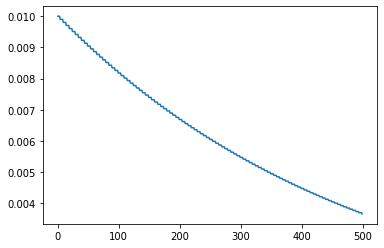

In [ ]:
test_opt = torch.optim.SGD(test.parameters(), lr=0.01)
test_scheduler = torch.optim.lr_scheduler.StepLR(test_opt, step_size=5, gamma=0.99)
nb = 500
lrs = np.zeros(nb)
for i in range(nb):
  for j in range(200):
    test_opt.zero_grad()
    test_opt.step()
  test_scheduler.step()
  lrs[i] = test_opt.state_dict()['param_groups'][0]['lr']
plt.plot(lrs)

Output of the first training image without training

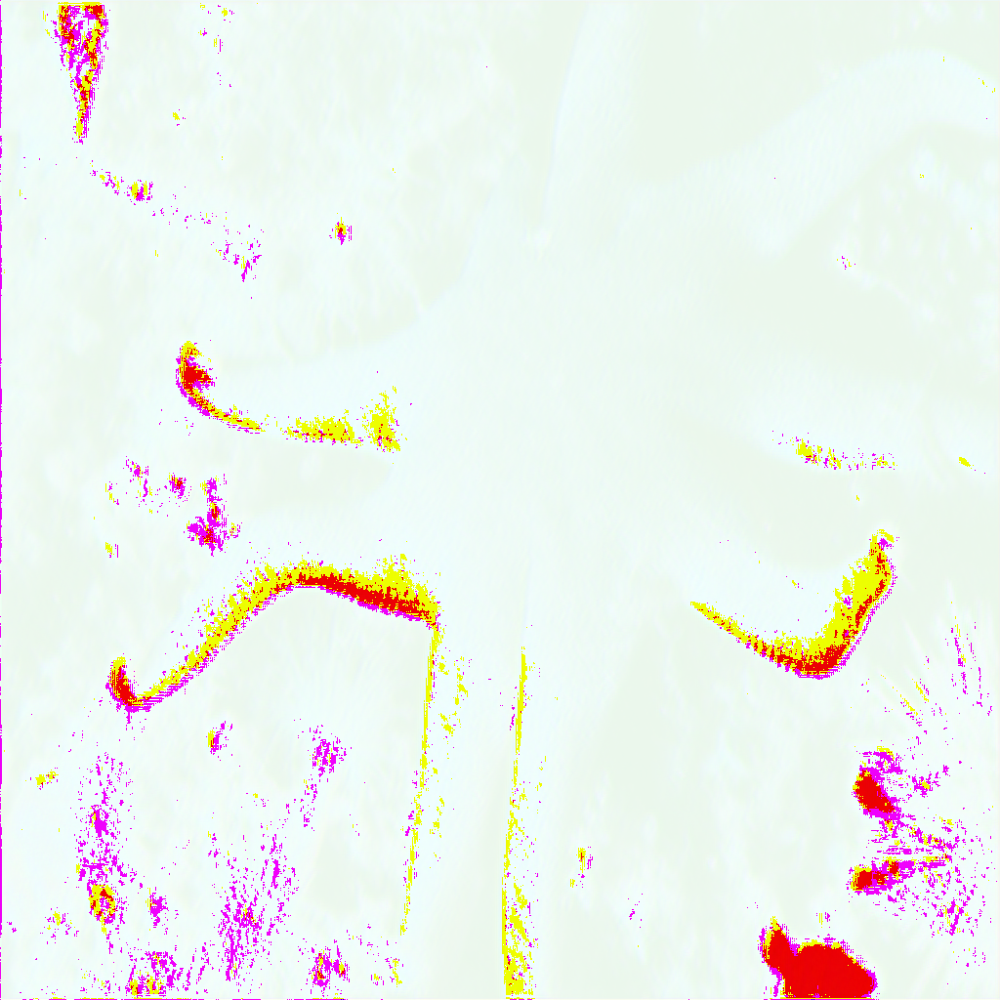

In [ ]:
input = torch.zeros([1,3,1024, 1024])
input[0] = data[0][0]
output = test.forward(input)
torchvision.transforms.ToPILImage()(output[0])

With training 3 epochs

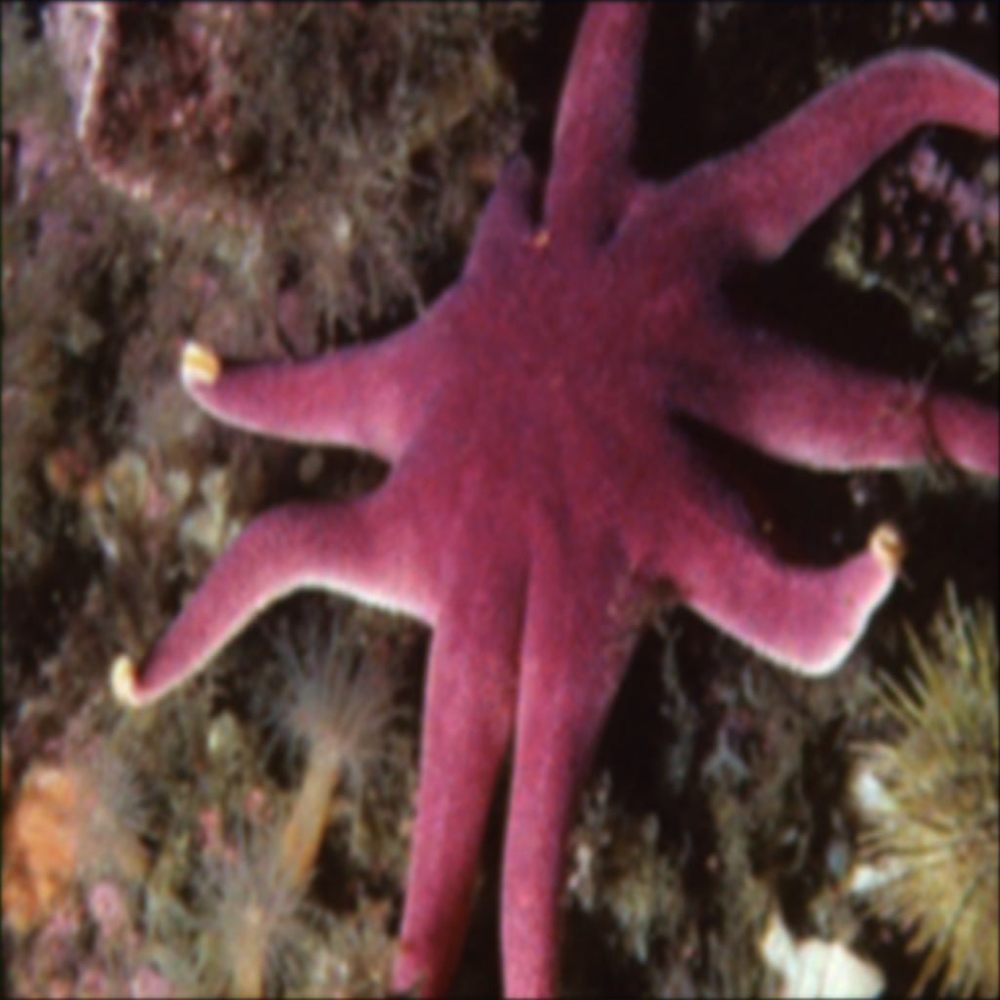

In [ ]:
input = torch.zeros([1,3,1024, 1024])
input[0] = data[0][0]
output = test.forward(input)
torchvision.transforms.ToPILImage()(output[0])

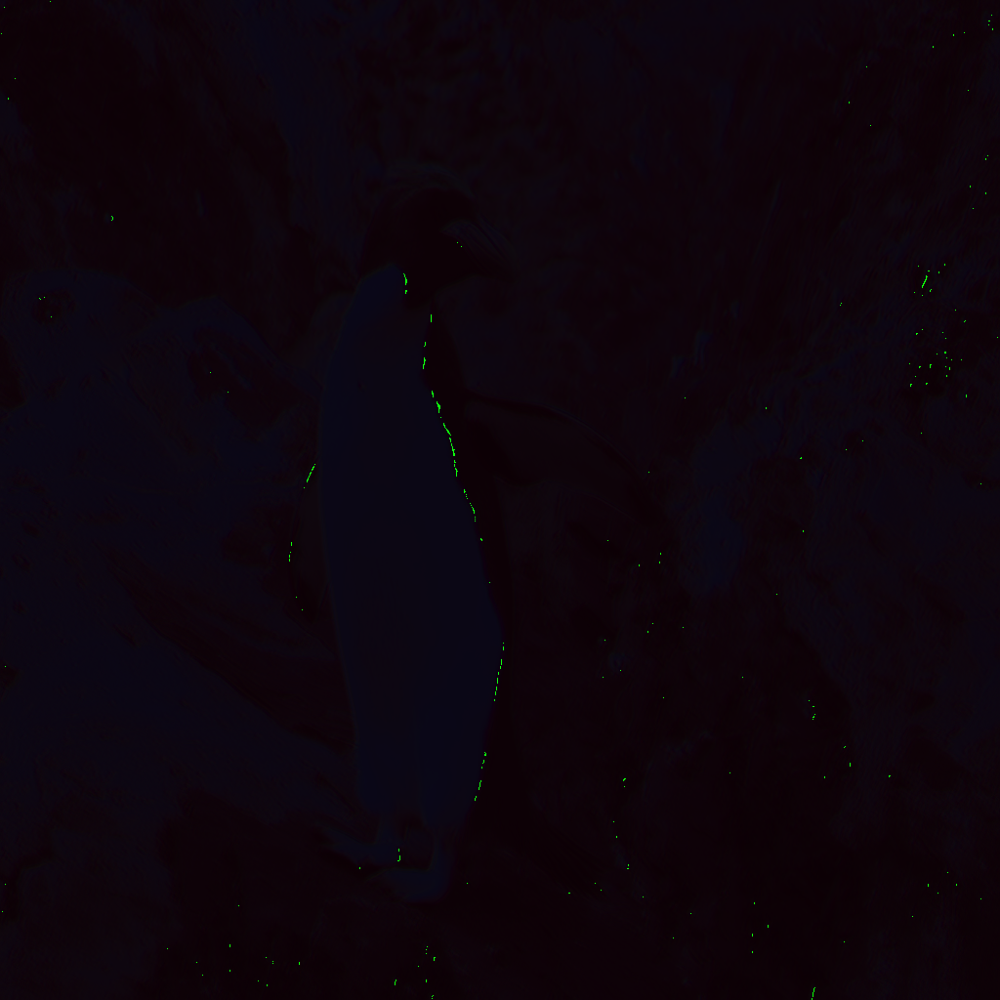

In [ ]:
input = torch.zeros([1,3,1024, 1024])
input[0] = data_test[0][0]
output = conv.forward(input)
torchvision.transforms.ToPILImage()(output[0])

It takes 1 hour to train an epoch

In [ ]:
def SRCNN_preprocessing_output(img):
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)

def SRCNN_preprocessing_input(img):
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)

data = DIV2KLoader('DIV2K_train_LR_clean_REAL_ESRGAN_output', 'DIV2K_train_HR', preprocessing_input= SRCNN_preprocessing_input, preprocessing_output= SRCNN_preprocessing_output)
data_test = DIV2KLoader('DIV2K_valid_LR_clean_REAL_ESRGAN_output', 'DIV2K_valid_HR', preprocessing_input= SRCNN_preprocessing_input, preprocessing_output= SRCNN_preprocessing_output)

data_loader = torch.utils.data.DataLoader(
        data, batch_size=2, shuffle=True, num_workers=2)

data_loader_test = torch.utils.data.DataLoader(
        data_test, batch_size=2, shuffle=False, num_workers=2)

data.restrict_size(200)
data_test.restrict_size(35)

conv.loss_fn = SSIM_loss(win_size=11, win_sigma=1.5, data_range=1)
conv.exec_training(data_loader, data_loader_test, 10, path_to_table='drive/MyDrive/ML/Indiv_Project/new_cnn_ssim_training.csv', path_to_model='drive/MyDrive/ML/Indiv_Project/new_cnn_ssim_model.pth')

Epoch 1
-------------------------------
loss: 0.783384  [    0/  200]
loss: 0.559960  [    2/  200]
loss: 0.464539  [    4/  200]
loss: 0.679833  [    6/  200]
loss: 0.738517  [    8/  200]
loss: 0.344119  [   10/  200]
loss: 0.429047  [   12/  200]
loss: 0.496734  [   14/  200]
loss: 0.551485  [   16/  200]
loss: 0.330458  [   18/  200]
loss: 0.734135  [   20/  200]
loss: 0.426772  [   22/  200]
loss: 0.403837  [   24/  200]
loss: 0.543220  [   26/  200]
loss: 0.423832  [   28/  200]
loss: 0.277340  [   30/  200]
loss: 0.530556  [   32/  200]
loss: 0.433370  [   34/  200]
loss: 0.355487  [   36/  200]
loss: 0.325502  [   38/  200]
loss: 0.578101  [   40/  200]
loss: 0.571002  [   42/  200]
loss: 0.474360  [   44/  200]
loss: 0.508058  [   46/  200]
loss: 0.589403  [   48/  200]
loss: 0.522787  [   50/  200]
loss: 0.488192  [   52/  200]
loss: 0.394531  [   54/  200]
loss: 0.421524  [   56/  200]
loss: 0.466245  [   58/  200]
loss: 0.375460  [   60/  200]
loss: 0.414888  [   62/  200]


In [ ]:
torch.save({'epochs': test.cur_epoch, 'model_state_dict': test.state_dict(), 'optimizer_state_dict': test.opt.state_dict(), 'loss_fn': test.loss_fn, 'lr_scheduler_state_dict': test.scheduler.state_dict()},'drive/MyDrive/ML/Indiv_Project/cnn_model.pth')

Analysis of the optimizer's efficiency by simulating the backpropagation process

In [ ]:
Xs = np.linspace(0.1,30,100)
function = lambda x: np.sin(x*.1) * np.sin(x*.1) * np.log(x*.1)
functions_Ys = function(Xs)
epochs = [i for i in range(30)]
attempts = []

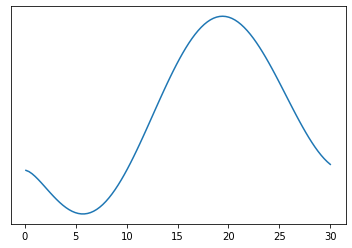

In [ ]:
fig = plt.plot(Xs, functions_Ys)
fig[0].axes.get_yaxis().set_visible(False)

In [ ]:
random_X = np.random.randint(0,len(Xs))
weight = torch.tensor(functions_Ys[random_X])
weights = [weight.item()]
weight_Xs = [Xs[random_X]]
weight

tensor(0.3502, dtype=torch.float64)

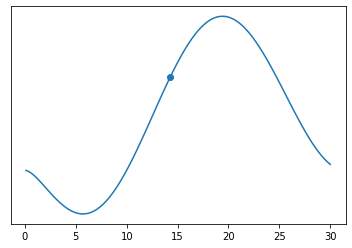

In [ ]:
fig2 = plt.scatter(weight_Xs, weights)
fig = plt.plot(Xs, functions_Ys)
fig[0].axes.get_yaxis().set_visible(False)

In [ ]:
optimizer = torch.optim.SGD([weight], lr=0.01, momentum = .9)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.9)

In [ ]:
optimizer.step()

In [ ]:
optimizer.state_dict()

{'param_groups': [{'dampening': 0,
   'initial_lr': 0.01,
   'lr': 0.01,
   'momentum': 0.9,
   'nesterov': False,
   'params': [0],
   'weight_decay': 0}],
 'state': {}}

In [ ]:
state_dict['param_groups']

[{'dampening': 0,
  'initial_lr': 0.01,
  'lr': 0.004782969000000002,
  'momentum': 0.9,
  'nesterov': False,
  'params': [0, 1, 2, 3, 4, 5],
  'weight_decay': 0}]

In [ ]:
list(test.parameters())[0]

Parameter containing:
tensor([[[[-5.8342e-03, -1.0246e-03, -3.7824e-02,  ..., -5.3396e-02,
           -4.7782e-02,  2.4010e-02],
          [ 4.9570e-02,  1.8368e-02,  1.6948e-02,  ...,  3.2977e-02,
            4.6639e-02,  2.7857e-02],
          [ 5.1918e-02, -2.4772e-02, -2.2349e-02,  ...,  4.7369e-03,
           -3.0260e-02,  2.1377e-02],
          ...,
          [-5.1110e-02, -1.1429e-02, -4.1309e-02,  ...,  6.2397e-02,
           -1.3117e-02,  4.1314e-02],
          [-3.7998e-02,  4.2419e-02, -2.8540e-02,  ...,  5.0801e-02,
            3.0303e-02,  5.7858e-02],
          [ 5.3953e-03, -4.4233e-02,  6.0129e-02,  ...,  4.2500e-03,
            2.2284e-02, -4.2123e-02]],

         [[-6.1389e-02,  4.1316e-02, -4.3616e-02,  ...,  9.4303e-04,
           -3.9541e-02, -5.3912e-02],
          [-7.6303e-04, -4.3012e-02, -2.3886e-02,  ..., -5.6388e-02,
            3.2996e-02, -2.8083e-02],
          [ 2.4710e-02, -3.4610e-02,  8.2691e-04,  ...,  2.1859e-02,
            3.4535e-02,  4.5110e-02]

# New Approach - SSIM as loss function

The Structural similarity index (SSIM) is a better indicator of the similarity between images than the mean squared error we've been using as a loss fucntion until now. Let's use it as our loss function from now on, hoping it will improve the training and performance of the model.

We are still using a smaller dataset for this small test.
We will compare it's evolution to the 500 epochs of the previous test.

Let's create the loss function from the SSIM.

In [ ]:
new_data = DIV2KLoader('DIV2K_train_LR_mild', 'DIV2K_train_HR')
new_data_test = DIV2KLoader('DIV2K_valid_LR_mild', 'DIV2K_valid_HR')

data.restrict_size(5)
data_test.restrict_size(5)

new_data_loader = torch.utils.data.DataLoader(
        data, batch_size=batch_size, shuffle=True, num_workers=2)

new_data_loader_test = torch.utils.data.DataLoader(
        data_test, batch_size=batch_size, shuffle=False, num_workers=2)
ssim_cnn_model = ConvolutionalNN()
ssim = SSIM_loss(win_size=11, win_sigma=1.5, data_range=1)
# ssim_cnn_model.load('drive/MyDrive/ML/Indiv_Project/ssim_cnn_model.pth')

Record the first loss of the model

In [ ]:
new_model.record('drive/MyDrive/ML/Indiv_Project/ssim_CNN_training.csv', ['Epochs','Loss'])
new_model.record('drive/MyDrive/ML/Indiv_Project/ssim_CNN_training.csv', [0,ssim_cnn_model.test(new_data_loader)])

Recorded Successfully!
Avg loss: 0.899718 

Recorded Successfully!


In [ ]:
ssim_cnn_model.exec_training(new_data_loader, None, 1000, path_to_table='drive/MyDrive/ML/Indiv_Project/ssim_CNN_training.csv', path_to_model='drive/MyDrive/ML/Indiv_Project/ssim_cnn_model.pth')

Epoch 501
-------------------------------
loss: 0.465346  [    0/    5]
Avg loss: 0.040694
Saved Successfully!
Recorded Successfully!


Epoch 502
-------------------------------
loss: 0.566375  [    0/    5]
Avg loss: 0.038674
Saved Successfully!
Recorded Successfully!


Epoch 503
-------------------------------
loss: 0.479898  [    0/    5]
Avg loss: 0.040403
Saved Successfully!
Recorded Successfully!


Epoch 504
-------------------------------
loss: 0.566375  [    0/    5]
Avg loss: 0.038674
Saved Successfully!
Recorded Successfully!


Epoch 505
-------------------------------
loss: 0.465346  [    0/    5]
Avg loss: 0.040694
Saved Successfully!
Recorded Successfully!


Epoch 506
-------------------------------
loss: 0.533169  [    0/    5]
Avg loss: 0.039338
Saved Successfully!
Recorded Successfully!


Epoch 507
-------------------------------
loss: 0.488477  [    0/    5]
Avg loss: 0.040232
Saved Successfully!
Recorded Successfully!


Epoch 508
-------------------------------
loss: 

After 500 epochs:

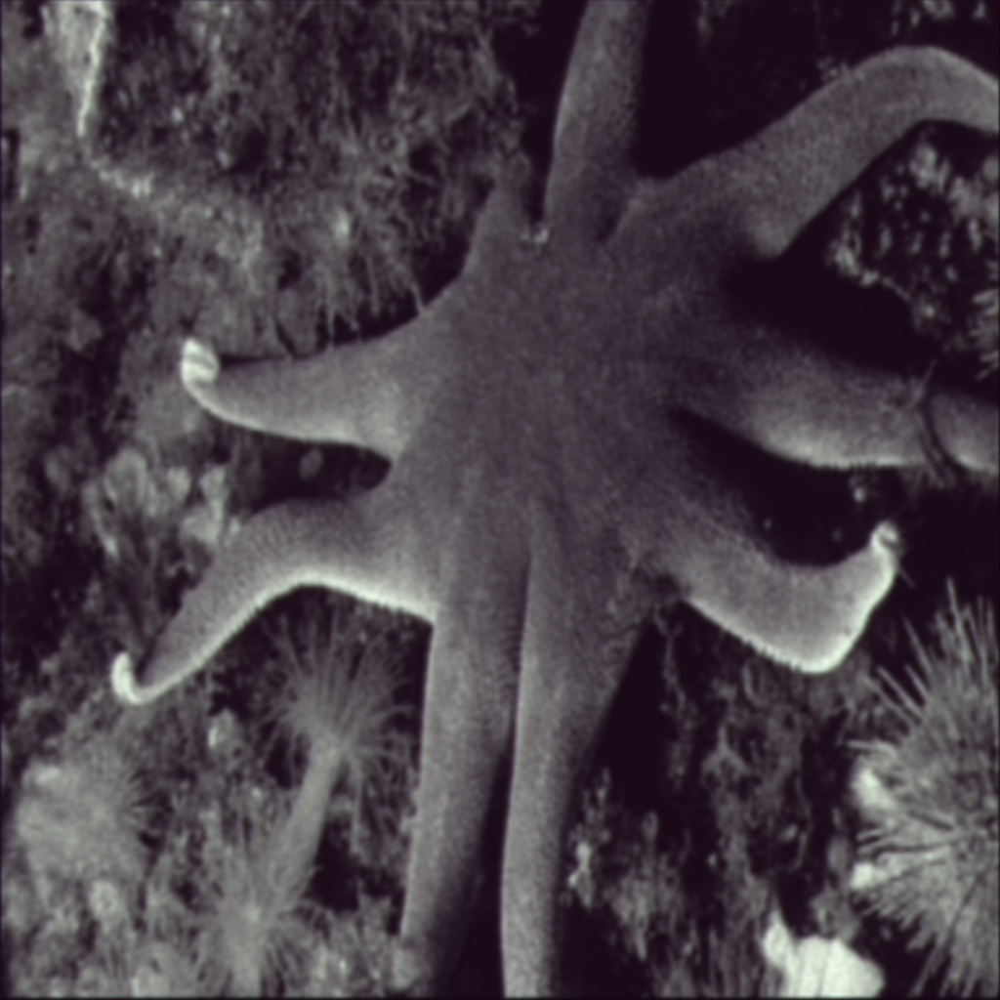

In [ ]:
input = torch.zeros([1,3,1024, 1024])
input[0] = new_data[0][0]
output = ssim_cnn_model.forward(input)
torchvision.transforms.ToPILImage()(output[0])

# New approach - Small dataset

## Progressively increasing dataset.


In [ ]:
def SRCNN_preprocessing_output(img):
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)

def SRCNN_preprocessing_input(img):
      img = img.resize((512,512),0)
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)

new_data = DIV2KLoader('DIV2K_train_LR_mild', 'DIV2K_train_HR', preprocessing_input=SRCNN_preprocessing_input, preprocessing_output=SRCNN_preprocessing_output)
new_data_test = DIV2KLoader('DIV2K_valid_LR_mild', 'DIV2K_valid_HR', preprocessing_input=SRCNN_preprocessing_input, preprocessing_output=SRCNN_preprocessing_output)

new_size = 200
new_data.restrict_size(new_size)
new_data_test.restrict_size(35)

new_data_loader = torch.utils.data.DataLoader(
        new_data, batch_size=batch_size, shuffle=True, num_workers=2)

new_data_loader_test = torch.utils.data.DataLoader(
        new_data_test, batch_size=batch_size, shuffle=False, num_workers=2)

new_model = ConvolutionalNN()
ssim = SSIM_loss(win_size=11, win_sigma=1.5, data_range=1)
new_model.loss_fn= ssim
new_model.load('drive/MyDrive/ML/Indiv_Project/cnn_step_model.pth')

Record the first loss of the model

In [ ]:
# new_model.record('drive/MyDrive/ML/Indiv_Project/CNN_step_training.csv', ['Epochs','Loss'])
# new_model.record('drive/MyDrive/ML/Indiv_Project/CNN_step_training.csv', [0,new_model.test(new_data_loader_test)])

Recorded Successfully!
Avg loss: 0.546304 

Recorded Successfully!


Train the model

1m40 for 15 images
=> 17 min for 1 epoch of 200 images
=> 500 epochs in 5 days 21 hours

In [ ]:
new_model.exec_training(new_data_loader, new_data_loader_test, 300)#, path_to_table='drive/MyDrive/ML/Indiv_Project/CNN_step_training.csv', path_to_model='drive/MyDrive/ML/Indiv_Project/cnn_step_model.pth')

Epoch 256
-------------------------------
loss: 0.670823  [    0/  200]
loss: 0.373149  [    4/  200]
loss: 0.482279  [    8/  200]
loss: 0.385711  [   12/  200]
loss: 0.399893  [   16/  200]
loss: 0.459796  [   20/  200]
loss: 0.549543  [   24/  200]
loss: 0.410867  [   28/  200]
loss: 0.436235  [   32/  200]
loss: 0.571236  [   36/  200]
loss: 0.524356  [   40/  200]
loss: 0.644580  [   44/  200]
loss: 0.510006  [   48/  200]
loss: 0.318113  [   52/  200]
loss: 0.412449  [   56/  200]
loss: 0.546453  [   60/  200]
loss: 0.545259  [   64/  200]
loss: 0.556604  [   68/  200]
loss: 0.391530  [   72/  200]
loss: 0.547089  [   76/  200]
loss: 0.508236  [   80/  200]
loss: 0.583280  [   84/  200]
loss: 0.355817  [   88/  200]
loss: 0.470720  [   92/  200]
loss: 0.575346  [   96/  200]
loss: 0.376747  [  100/  200]
loss: 0.509327  [  104/  200]
loss: 0.477029  [  108/  200]
loss: 0.486136  [  112/  200]
loss: 0.614651  [  116/  200]
loss: 0.360641  [  120/  200]
loss: 0.449886  [  124/  200

KeyboardInterrupt: ignored

After 500 epochs:

In [ ]:
input = torch.zeros([1,3,1024, 1024])
for i in range(10):
  input[0] = new_data[i][0]
  output = new_model.forward(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

# Fast SRCNN

In [35]:
class F_CNN(NeuralNetwork):
  def __init__(self, d=64, s=32, scale = 3) -> None:
      super().__init__()
      _kernel_size, _stride, _padding, _output_padding, _dilation = 9, scale, 0, 0, 1
      _padding = (- (scale - 1) + _dilation*(_kernel_size - 1)) // 2


      self.model = nn.Sequential(
          # Feature extraction
          nn.Conv2d(3, d, 5, 1, 2),
          nn.PReLU(),

          # Shrinking
          nn.Conv2d(d, s, 1, 1, 0),
          nn.PReLU(),

          # Mapping (m = 4)
          nn.Conv2d(s, s, 3, 1, 1),
          nn.PReLU(),
          nn.Conv2d(s, s, 3, 1, 1),
          nn.PReLU(),
          nn.Conv2d(s, s, 3, 1, 1),
          nn.PReLU(),
          nn.Conv2d(s, s, 3, 1, 1),
          nn.PReLU(),

          # Expanding
          nn.Conv2d(s, d, 1, 1, 0),
          nn.PReLU(),

          # Deconvolution
          nn.ConvTranspose2d(d, 3, _kernel_size, _stride, _padding, _output_padding))

      self.opt = torch.optim.SGD(self.parameters(), lr=0.01)
      self.scheduler = torch.optim.lr_scheduler.StepLR(self.opt, step_size=100, gamma=0.5)
      # self.loss_fn = SSIM_loss(win_size=11, win_sigma=1.5, data_range=1)
      self.loss_fn = nn.MSELoss()
  
  def load(self, path):
      saved_info = torch.load(path)
      self.load_state_dict(saved_info['model_state_dict'])
      self.opt.load_state_dict(saved_info['optimizer_state_dict'])
      self.scheduler.load_state_dict(saved_info['lr_scheduler_state_dict'])
      self.cur_epoch = saved_info['epochs'] + 1
      self.loss_fn = saved_info['loss_fn']

  def save(self,path):
      torch.save({'epochs': self.cur_epoch, 'model_state_dict': self.state_dict(), 'optimizer_state_dict': self.opt.state_dict(), 'loss_fn': self.loss_fn, 'lr_scheduler_state_dict': self.scheduler.state_dict()}, path)
      print("Saved Successfully!")

In [38]:
def FSRCNN_preprocessing_input(img: Image):
      max_size = 170
      width, height = img.size
      if width > height:
        width, height = max_size, int(height * max_size / width)
      else:
        width, height = int(width * max_size / height), max_size
      img = img.resize((width,height),0)
      return torchvision.transforms.ToTensor()(img)

def FSRCNN_preprocessing_output(img: Image):
      max_size = 510
      width, height = img.size
      if width > height:
        width, height = max_size, int(height * max_size / width)
      else:
        width, height = int(width * max_size / height), max_size
      img = img.resize((width,height),0)
      return torchvision.transforms.ToTensor()(img)


new_data = DIV2KLoader('DIV2K_train_LR_clean', 'DIV2K_train_LR_clean', preprocessing_input= FSRCNN_preprocessing_input)
new_data_test = DIV2KLoader('DIV2K_valid_LR_clean', 'DIV2K_valid_LR_clean', preprocessing_input= FSRCNN_preprocessing_input)

new_size = 100
new_data.restrict_size(new_size)
new_data_test.restrict_size(25)

new_data_loader = torch.utils.data.DataLoader(
        new_data, batch_size=1, shuffle=True, num_workers=2)

new_data_loader_test = torch.utils.data.DataLoader(
        new_data_test, batch_size=1, shuffle=False, num_workers=2)

f_model = F_CNN(d=48,s=12)
# f_model.load('drive/MyDrive/ML/Indiv_Project/Second_Year/fsrcnn_mse_x3_m_4_d_48_s_12/fsrcnn_8th_data.pth')

In [19]:
summary(f_model, (3,170,170), device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 48, 170, 170]           3,648
             PReLU-2         [-1, 48, 170, 170]               1
            Conv2d-3         [-1, 12, 170, 170]             588
             PReLU-4         [-1, 12, 170, 170]               1
            Conv2d-5         [-1, 12, 170, 170]           1,308
             PReLU-6         [-1, 12, 170, 170]               1
            Conv2d-7         [-1, 12, 170, 170]           1,308
             PReLU-8         [-1, 12, 170, 170]               1
            Conv2d-9         [-1, 12, 170, 170]           1,308
            PReLU-10         [-1, 12, 170, 170]               1
           Conv2d-11         [-1, 12, 170, 170]           1,308
            PReLU-12         [-1, 12, 170, 170]               1
           Conv2d-13         [-1, 48, 170, 170]             624
            PReLU-14         [-1, 48, 1

5 mins per epoch => 12 epoch per hour

8 min per epoch of 200 images for m=3, d=64, s=32

6 min per epoch of 200 images for m=3, d=64, s=16

In [50]:
f_model.scheduler.step_size = 100000
f_model.scheduler.learning_rate = 1e-3

In [ ]:
# Minutes
time_1_epoch = 18 / 60
f_model.exec_training(new_data_loader, new_data_loader_test, int(60 * 4 / time_1_epoch), path_to_table='drive/MyDrive/ML/Indiv_Project/Second_Year/fsrcnn_mse_x3_m_4_d_48_s_12/fsrcnn_8th_data.csv', path_to_model='drive/MyDrive/ML/Indiv_Project/Second_Year/fsrcnn_mse_x3_m_4_d_48_s_12/fsrcnn_8th_data.pth')

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
loss: 0.038736  [   17/  100]
loss: 0.035500  [   18/  100]
loss: 0.005962  [   19/  100]
loss: 0.003413  [   20/  100]
loss: 0.018664  [   21/  100]
loss: 0.007407  [   22/  100]
loss: 0.019736  [   23/  100]
loss: 0.017450  [   24/  100]
loss: 0.022233  [   25/  100]
loss: 0.019286  [   26/  100]
loss: 0.013945  [   27/  100]
loss: 0.020329  [   28/  100]
loss: 0.010858  [   29/  100]
loss: 0.010314  [   30/  100]
loss: 0.023972  [   31/  100]
loss: 0.016960  [   32/  100]
loss: 0.008556  [   33/  100]
loss: 0.005622  [   34/  100]
loss: 0.013855  [   35/  100]
loss: 0.012795  [   36/  100]
loss: 0.027622  [   37/  100]
loss: 0.008213  [   38/  100]
loss: 0.019953  [   39/  100]
loss: 0.023041  [   40/  100]
loss: 0.021524  [   41/  100]
loss: 0.018680  [   42/  100]
loss: 0.012090  [   43/  100]
loss: 0.018909  [   44/  100]
loss: 0.006875  [   45/  100]
loss: 0.012326  [   46/  100]
loss: 0.008491  [   47

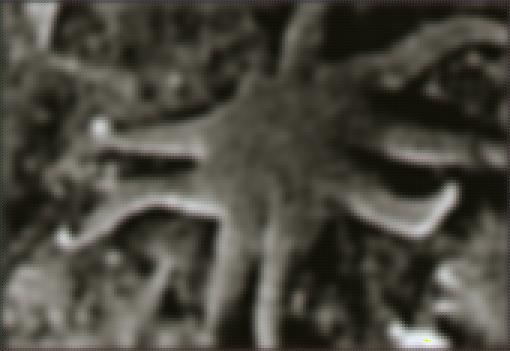

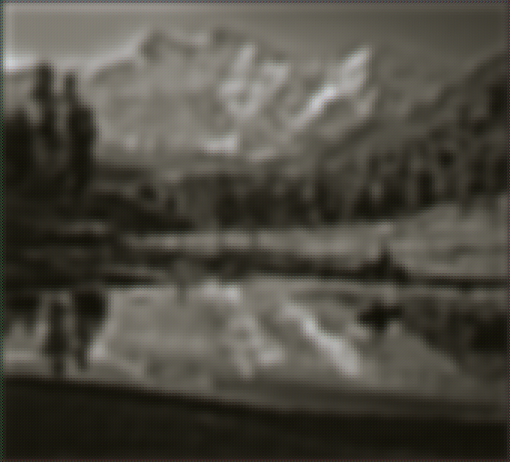

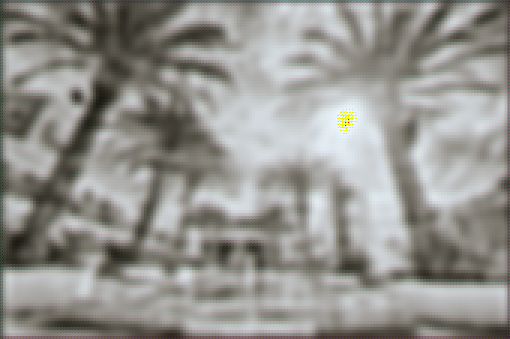

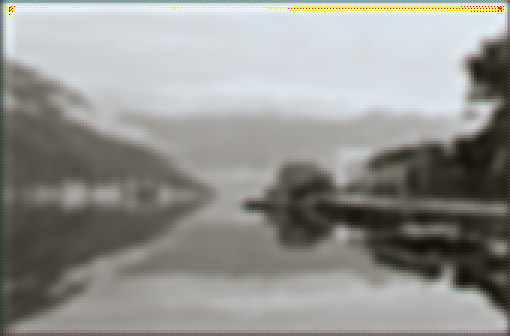

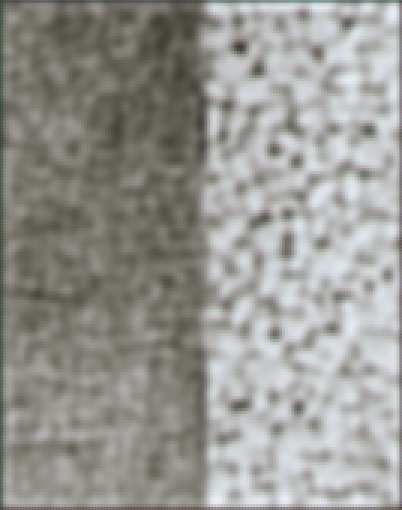

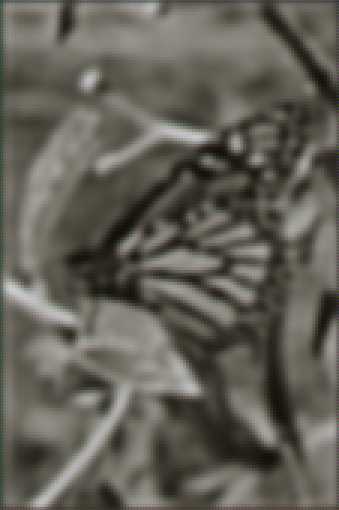

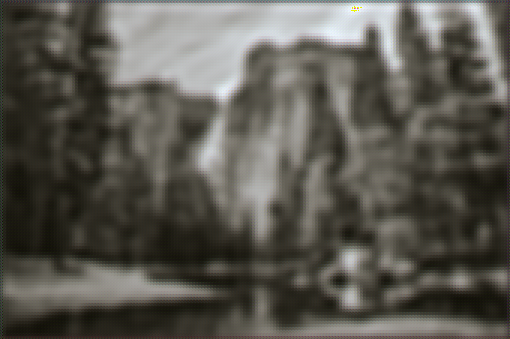

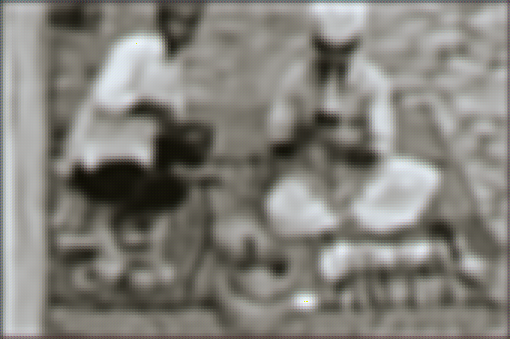

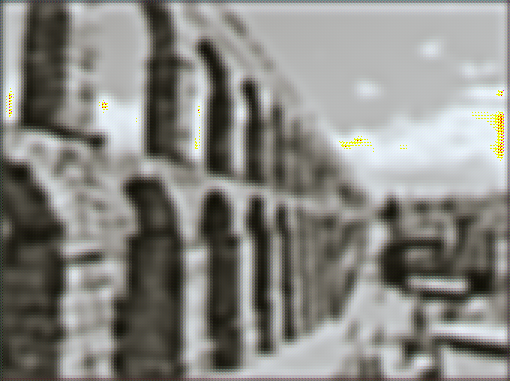

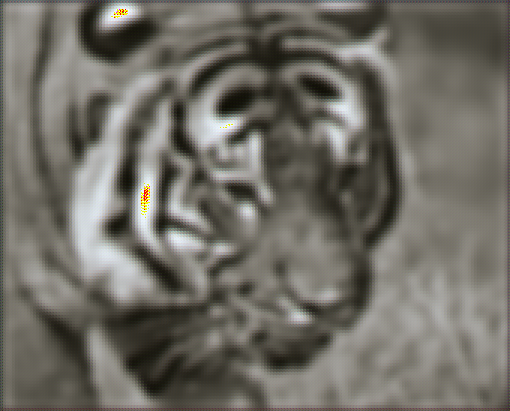

In [47]:
for i in range(10):
  input = torch.zeros([1, 3, new_data[i][0].shape[1], new_data[i][0].shape[2]])
  input[0] = new_data[i][0]
  output = f_model(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

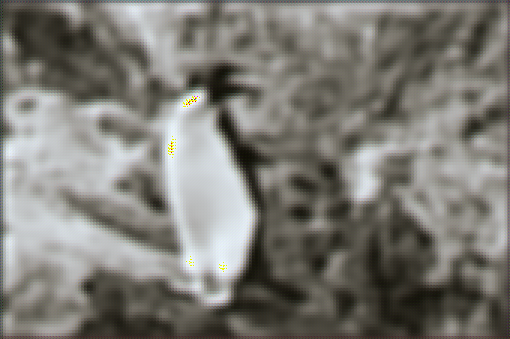

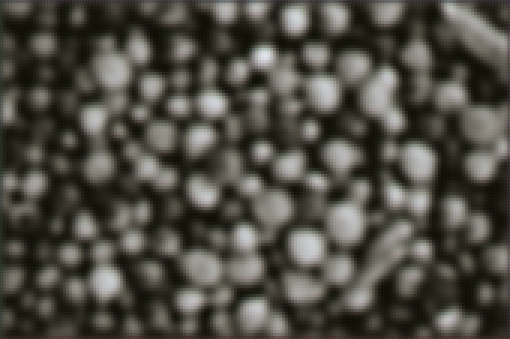

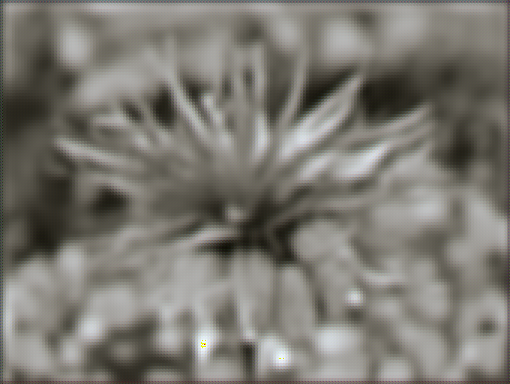

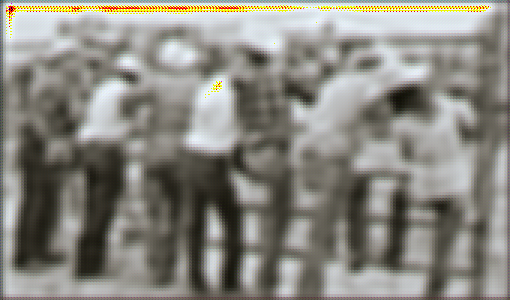

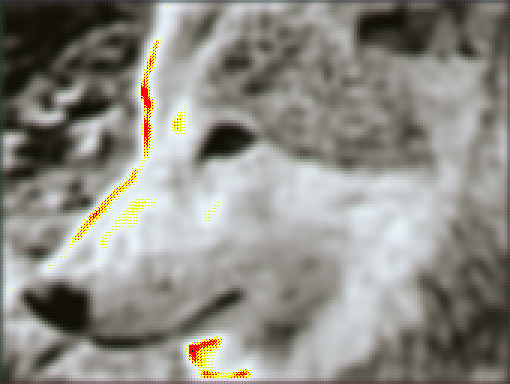

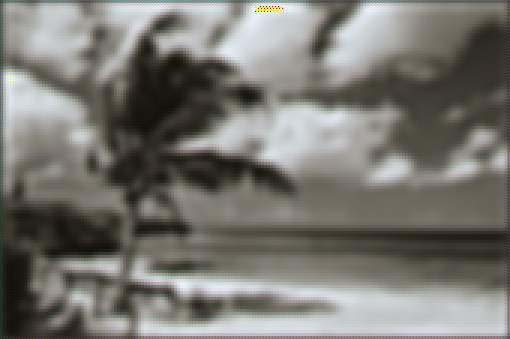

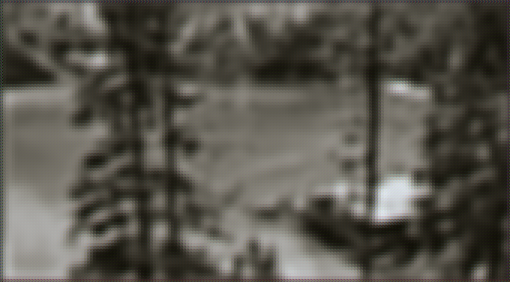

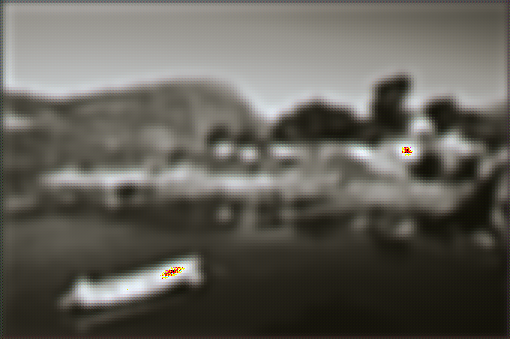

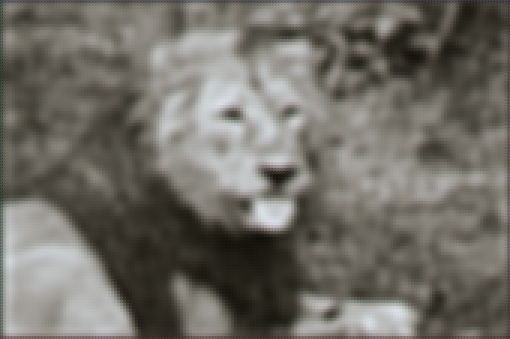

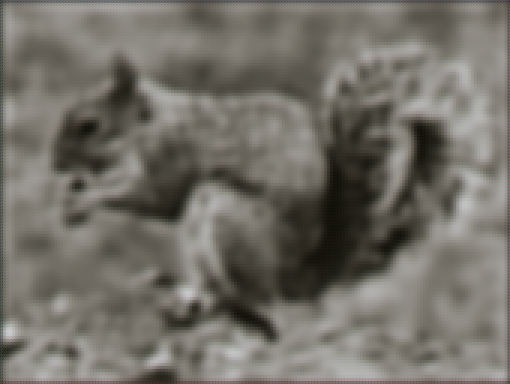

In [48]:
for i in range(10):
  input = torch.zeros([1, 3, new_data_test[i][0].shape[1], new_data_test[i][0].shape[2]])
  input[0] = new_data_test[i][0]
  output = f_model(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

# Fine Tunning

Because we don't have enough time for training. We can take a pretrained model and fine-tune it to our database through additional training.

Let's set it up.

Fine Tuning

Original code of the state-of-the-art super-resolution model: Real-ESRGAN.
We will use it as a base for our finetuned model and add the SRCNN model to reduce training time.

We ran the predicted model on the low-resolution images. They will become the new training input for our SRCNN.

In [ ]:
class OutputLoader(DIV2KLoader):
  def __init__(self):
    super().__init__('Real-ESRGAN/results')
  
  def __getitem__(self, i):
    # Get the size of the uploaded image
    original_filename_split = path.splitext(self.img_names[i])
    original_filename = original_filename_split[0][:-4] + original_filename_split[1]
    width, height = Image.open(Path('Real-ESRGAN/upload').joinpath(original_filename)).size

    if width > height:
      width, height = 1024, int(height * 1024 / width)
    else:
      width, height = int(width * 1024 / height), 1024

    # Get the right image
    img = Image.open(Path(self.low_res_folder).joinpath(self.img_names[i]))
    return self.preprocessing_input(img), self.img_names[i], width, height


class FineTunedCNN(ConvolutionalNN):
  def __init__(self):
    super().__init__()

  def infer(self, dataloader: OutputLoader):
      self.eval()
      
      with torch.no_grad():
            for X, filenames, widths, heights in dataloader:

              pred = self(X)
              for i in range(len(pred)):
                image = torchvision.transforms.ToPILImage()(pred[i]).resize((widths[i],heights[i]))
                image.save('Real-ESRGAN/results/' + filenames[i])

      print(f"The images are saved in 'Real-ESRGAN/results/'")

In [ ]:
def SRCNN_preprocessing_output(img):
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)

def SRCNN_preprocessing_input(img):
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)

new_data = DIV2KLoader('DIV2K_train_LR_clean_REAL_ESRGAN_output', 'DIV2K_train_HR', preprocessing_input=SRCNN_preprocessing_input, preprocessing_output=SRCNN_preprocessing_output)
new_data_test = DIV2KLoader('DIV2K_valid_LR_clean_REAL_ESRGAN_output', 'DIV2K_valid_HR', preprocessing_input=SRCNN_preprocessing_input, preprocessing_output=SRCNN_preprocessing_output)

new_size = 400
new_data.restrict_size(new_size)
new_data_test.restrict_size(50)

batch_size = 4

new_data_loader = torch.utils.data.DataLoader(
        new_data, batch_size=batch_size, shuffle=True, num_workers=2)

new_data_loader_test = torch.utils.data.DataLoader(
        new_data_test, batch_size=batch_size, shuffle=False, num_workers=2)

extension_model = FineTunedCNN()
ssim = SSIM_loss(win_size=11, win_sigma=1.5, data_range=1)
extension_model.loss_fn = ssim
extension_model.load('drive/MyDrive/ML/Indiv_Project/extension_model_mse.pth')

AttributeError: ignored

In [ ]:
extension_model.loss_fn = nn.MSELoss()
extension_model.exec_training(new_data_loader, new_data_loader_test, 200, path_to_table='drive/MyDrive/ML/Indiv_Project/extension_training_mse.csv', path_to_model='drive/MyDrive/ML/Indiv_Project/extension_model_mse.pth')

Epoch 151
-------------------------------
loss: 0.003010  [    0/  400]
loss: 0.003416  [    4/  400]
loss: 0.005648  [    8/  400]
loss: 0.002660  [   12/  400]
loss: 0.002567  [   16/  400]
loss: 0.003149  [   20/  400]
loss: 0.003017  [   24/  400]
loss: 0.004956  [   28/  400]
loss: 0.006998  [   32/  400]
loss: 0.006185  [   36/  400]
loss: 0.007839  [   40/  400]
loss: 0.003376  [   44/  400]
loss: 0.004981  [   48/  400]
loss: 0.003372  [   52/  400]
loss: 0.006212  [   56/  400]
loss: 0.003470  [   60/  400]
loss: 0.002977  [   64/  400]
loss: 0.003055  [   68/  400]
loss: 0.005374  [   72/  400]
loss: 0.001610  [   76/  400]
loss: 0.007801  [   80/  400]
loss: 0.002922  [   84/  400]
loss: 0.001585  [   88/  400]
loss: 0.003807  [   92/  400]
loss: 0.002420  [   96/  400]
loss: 0.004508  [  100/  400]
loss: 0.002243  [  104/  400]
loss: 0.003691  [  108/  400]
loss: 0.003847  [  112/  400]
loss: 0.003420  [  116/  400]
loss: 0.003587  [  120/  400]
loss: 0.004364  [  124/  400

In [ ]:
# extension_model.record('drive/MyDrive/ML/Indiv_Project/extension_training.csv', ['Epochs','Loss'])
# extension_model.record('drive/MyDrive/ML/Indiv_Project/extension_training.csv', [0,extension_model.test(new_data_loader_test)])

Recorded Successfully!
Recorded Successfully!


In [ ]:
extension_model.loss_fn = ssim
extension_model.exec_training(new_data_loader, new_data_loader_test, 50, path_to_table='drive/MyDrive/ML/Indiv_Project/extension_training.csv', path_to_model='drive/MyDrive/ML/Indiv_Project/extension_model.pth')

Epoch 36
-------------------------------
loss: 0.296004  [    0/  400]
loss: 0.320292  [    4/  400]
loss: 0.287246  [    8/  400]
loss: 0.276560  [   12/  400]
loss: 0.158991  [   16/  400]
loss: 0.260557  [   20/  400]
loss: 0.270660  [   24/  400]
loss: 0.268286  [   28/  400]
loss: 0.286619  [   32/  400]
loss: 0.196061  [   36/  400]
loss: 0.183874  [   40/  400]
loss: 0.225200  [   44/  400]
loss: 0.179760  [   48/  400]
loss: 0.316375  [   52/  400]
loss: 0.240825  [   56/  400]
loss: 0.252632  [   60/  400]
loss: 0.218609  [   64/  400]
loss: 0.192487  [   68/  400]
loss: 0.180284  [   72/  400]
loss: 0.185185  [   76/  400]
loss: 0.345793  [   80/  400]
loss: 0.129269  [   84/  400]
loss: 0.146800  [   88/  400]
loss: 0.215829  [   92/  400]
loss: 0.254169  [   96/  400]
loss: 0.172135  [  100/  400]
loss: 0.340139  [  104/  400]
loss: 0.171000  [  108/  400]
loss: 0.223939  [  112/  400]
loss: 0.232949  [  116/  400]
loss: 0.240781  [  120/  400]
loss: 0.194620  [  124/  400]

Validation set at the last trained epoch

In [ ]:
input = torch.zeros([1,3,1024, 1024])
for i in range(len(new_data_test)):
  input[0] = new_data_test[i][0]
  output = extension_model.forward(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

0 epochs

In [ ]:
input = torch.zeros([1,3,1024, 1024])
input[0] = new_data[0][0]
display(torchvision.transforms.ToPILImage()(input[0]))
output = extension_model.forward(input)
display(torchvision.transforms.ToPILImage()(output[0]))

In [ ]:
input = torch.zeros([1,3,1024, 1024])
for i in range(10):
  input[0] = new_data[i][0]
  output = extension_model.forward(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

3 epochs

In [ ]:
input = torch.zeros([1,3,1024, 1024])
for i in range(10):
  input[0] = new_data[i][0]
  output = extension_model.forward(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

16 epochs

In [ ]:
input = torch.zeros([1,3,1024, 1024])
for i in range(10):
  input[0] = new_data[i][0]
  output = extension_model.forward(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

50 epochs

In [ ]:
input = torch.zeros([1,3,1024, 1024])
for i in range(10):
  input[0] = new_data[i][0]
  output = extension_model.forward(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

After the 50th epoch trained with ssim loss, we switch to the MSE loss funtion to put more emphasis on the details. It's pixel-wise comparisons allows for a more efficient cleaning of the details.

100 epochs

In [ ]:
input = torch.zeros([1,3,1024, 1024])
for i in range(10):
  input[0] = new_data[i][0]
  output = extension_model.forward(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

150 epochs

In [ ]:
input = torch.zeros([1,3,1024, 1024])
for i in range(10):
  input[0] = new_data[i][0]
  output = extension_model.forward(input)
  display(torchvision.transforms.ToPILImage()(output[0]))

# Testing

# Inference

Code for inference: the pretrained model outputs a result and we aim at improving it with our personal model.

This inference code is highly inspired by the creator of the Real_ESRGAN model:
https://colab.research.google.com/drive/1k2Zod6kSHEvraybHl50Lys0LerhyTMCo?usp=sharing#scrollTo=u1tiyMZJW5td


This loads the pretrained model.

In [ ]:
# Clone Real-ESRGAN and enter the Real-ESRGAN
!git clone https://github.com/xinntao/Real-ESRGAN.git
%cd Real-ESRGAN
# Set up the environment
!pip install basicsr
!pip install facexlib
!pip install gfpgan
!pip install -r requirements.txt
!python setup.py develop
# Download the pre-trained model
!wget https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.0/RealESRGAN_x4plus.pth -P experiments/pretrained_models
%cd ..

Cloning into 'Real-ESRGAN'...
remote: Enumerating objects: 671, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 671 (delta 1), reused 5 (delta 1), pack-reused 665
Receiving objects: 100% (671/671), 5.02 MiB | 16.80 MiB/s, done.
Resolving deltas: 100% (356/356), done.
/content/Real-ESRGAN
     |████████████████████████████████| 161 kB 5.3 MB/s 
     |████████████████████████████████| 5.8 MB 33.6 MB/s 
     |████████████████████████████████| 190 kB 41.7 MB/s 
  Created wheel for basicsr: filename=basicsr-1.3.5-py3-none-any.whl size=194483 sha256=a80316e82f89247d84f075e2ebc38418b28a40b4f61af6c8c9d04f2f2a53a85d
  Stored in directory: /root/.cache/pip/wheels/74/1b/d0/8659cf028233dd1e3bf282271009fbf037dfc4ab761f32a032
Successfully built basicsr


     |████████████████████████████████| 59 kB 2.7 MB/s 
     |████████████████████████████████| 177 kB 9.9 MB/s 
  Created wheel for filterpy: filename=filterpy-1.4.5-py3-none-any.whl size=110474 sha256=6719696ac98ad01d3d1668e5a0a5aface6f2c277c91ae887c524cb730d3a59f2
  Stored in directory: /root/.cache/pip/wheels/ce/e0/ee/a2b3c5caab3418c1ccd8c4de573d4cbe13315d7e8b0a55fbc2
Successfully built filterpy
     |████████████████████████████████| 47 kB 2.4 MB/s 
     |████████████████████████████████| 15.3 MB 10.3 MB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.21.6
    Uninstalling numpy-1.21.6:
      Successfully uninstalled numpy-1.21.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.0 requires tf-estimator-nightly==2.8.0.dev2021122109, which is not installed.
datascience 0.10.6 requires folium==0.2.1, but you have folium 

running develop
running egg_info
creating realesrgan.egg-info
writing realesrgan.egg-info/PKG-INFO
writing dependency_links to realesrgan.egg-info/dependency_links.txt
writing requirements to realesrgan.egg-info/requires.txt
writing top-level names to realesrgan.egg-info/top_level.txt
writing manifest file 'realesrgan.egg-info/SOURCES.txt'
reading manifest template 'MANIFEST.in'
adding license file 'LICENSE'
writing manifest file 'realesrgan.egg-info/SOURCES.txt'
running build_ext
Creating /usr/local/lib/python3.7/dist-packages/realesrgan.egg-link (link to .)
Adding realesrgan 0.2.5.0 to easy-install.pth file

Installed /content/Real-ESRGAN
Processing dependencies for realesrgan==0.2.5.0
Searching for tqdm==4.64.0
Best match: tqdm 4.64.0
Adding tqdm 4.64.0 to easy-install.pth file
Installing tqdm script to /usr/local/bin

Using /usr/local/lib/python3.7/dist-packages
Searching for torchvision==0.12.0+cu113
Best match: torchvision 0.12.0+cu113
Adding torchvision 0.12.0+cu113 to easy-inst

Now, just need to save the images

In [ ]:
%cd Real-ESRGAN
import os
from google.colab import files
import shutil

upload_folder = 'upload'
result_folder = 'results'

if os.path.isdir(upload_folder):
    shutil.rmtree(upload_folder)
if os.path.isdir(result_folder):
    shutil.rmtree(result_folder)
os.mkdir(upload_folder)
os.mkdir(result_folder)

# upload images
uploaded = files.upload()
for filename in uploaded.keys():
  dst_path = os.path.join(upload_folder, filename)
  print(f'move {filename} to {dst_path}')
  shutil.move(filename, dst_path)
%cd ..

/content/Real-ESRGAN


Saving 0801x4m.png to 0801x4m.png
move 0801x4m.png to upload/0801x4m.png
/content


Runs the inference

In [ ]:
%cd Real-ESRGAN
if torch.cuda.is_available():
  !python inference_realesrgan.py -n RealESRGAN_x4plus -i upload
else:
  !python inference_realesrgan.py -n RealESRGAN_x4plus -i upload --fp32
%cd ..

/content/Real-ESRGAN
Testing 0 0801x4m
/content


The results are in the results folder. They will become inputs of our trained model.

In [ ]:
# Builds a dataset made of the infered results

custom_data = OutputLoader()

# Uses it in a dataloader

batch_size = 4

custom_data_loader = torch.utils.data.DataLoader(
        custom_data, batch_size=batch_size, shuffle=True, num_workers=2)

# Builds our model

my_model = FineTunedCNN()
ssim = SSIM_loss(win_size=11, win_sigma=1.5, data_range=1)
my_model.loss_fn = ssim
my_model.load('drive/MyDrive/ML/Indiv_Project/extension_model_mse.pth')

# Runs the prediction on the finetuned model and saves it in the results folder

my_model.infer(custom_data_loader)

The images are saved in 'Real-ESRGAN/results/'


In [ ]:
# Download the results
zip_filename = 'Real-ESRGAN_result.zip'
if os.path.exists(zip_filename):
  os.remove(zip_filename)
os.system(f"zip -r -j {zip_filename} results/*")
files.download(zip_filename)

# Study

In [ ]:
from skimage.metrics import peak_signal_noise_ratio, mean_squared_error
import cv2
import os
from google.colab import files

In [ ]:
def SRCNN_preprocessing_output(img):
      img = img.resize((1024,1024),0)
      return torchvision.transforms.ToTensor()(img)

def SRCNN_preprocessing_input(img):
      img = img.resize((1024,1024))
      return torchvision.transforms.ToTensor()(img)


data_test = DIV2KLoader('DIV2K_train_LR_mild_REAL_ESRGAN_output', 'DIV2K_train_LR_mild_REAL_ESRGAN_output', preprocessing_input= SRCNN_preprocessing_input)

# conv = ConvolutionalNN()
# conv.load('drive/MyDrive/ML/Indiv_Project/extension_model_mse.pth')

In [ ]:
for i in range(len(data_test)):
  result = conv(data_test[i][0])
  result_image = torchvision.transforms.ToPILImage()(result).resize((int(data_test[i][1].shape[2]/2), int(data_test[i][1].shape[1]/2)))
  result_image.save(f'DIV2K_train_LR_mild_finetuned/{"{:04d}".format(i+1)}.png') 
  # print(f'DIV2K_valid_LR_mild_REAL_ESRGAN_output/{"{:04d}".format(i+801)}.png')
os.system("zip -r -j Finetuned_Model_train_mild_output.zip DIV2K_train_LR_mild_finetuned/*")
files.download('Finetuned_Model_train_mild_output.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Finetuned model results : SSIM and PSNR

In [ ]:
for i in data_test:
  # Gets the 2k image
  target_image = torchvision.transforms.ToPILImage()(i[1])
  # Rescales the target image to 1K to suit our experiment
  # target_image = target_image.resize((int(target_image.size[0]/2), int(target_image.size[1]/2)))
  
  # Gets the 1k output of the pretrained model, runs the prediction and reshapes
  # it down to the original 1k size
  produced_image = torchvision.transforms.ToPILImage()(i[0])
  target_image = target_image.resize(produced_image.size)
  _ssim = SSIM(win_size=11, win_sigma=1.5, data_range=1)(torchvision.transforms.ToTensor()(produced_image).unsqueeze(0), torchvision.transforms.ToTensor()(target_image).unsqueeze(0))
  _psrn = peak_signal_noise_ratio(np.array(target_image), np.array(produced_image))
  print(f'{_ssim} - {_psrn}')

0.7525102496147156 - 22.513923363596604
0.7123939394950867 - 23.26449211193076
0.46673715114593506 - 17.580999466032683
0.4714524447917938 - 18.171541495365933
0.47240114212036133 - 18.746312051690676


KeyboardInterrupt: ignored

Nearest-neighbour results : SSIM and PSNR

In [ ]:
for i in data_test:
  # Gets the 2k image
  target_image = torchvision.transforms.ToPILImage()(i[1])
  # Rescales the target image to 1K to suit our experiment
  target_image.resize((int(target_image.size[0]/2), int(target_image.size[1]/2)))

  # Rescales the input image using nearest neighbour
  ssims = []
  psnrs = []
  result = i[0]
  for i in range(5):
    result = conv(result)
    produced_image = torchvision.transforms.ToPILImage()(result).resize((target_image.size), 0)
    _ssim = str(float(SSIM(win_size=11, win_sigma=1.5, data_range=1)(torchvision.transforms.ToTensor()(produced_image).unsqueeze(0), torchvision.transforms.ToTensor()(target_image).unsqueeze(0))))
    _psrn = str(peak_signal_noise_ratio(cv2.cvtColor(np.array(target_image), cv2.COLOR_RGB2BGR), cv2.cvtColor(np.array(produced_image), cv2.COLOR_RGB2BGR)))
    ssims.append(_ssim)
    psnrs.append(_psrn)

  print(f'{" ".join(ssims)}  {" ".join(psnrs)}')

0.8396772742271423 0.7955400943756104 0.7606367468833923 0.7294365763664246 0.699637234210968  28.245042505908632 26.82562608231446 25.59303041481147 24.482555167121834 23.466420495746707
0.8184732794761658 0.7448375821113586 0.6915439963340759 0.6489083170890808 0.6118372082710266  27.225256959791913 25.519446424601302 23.599415714625952 21.81441382892509 20.271887013647422
0.9194688200950623 0.895965576171875 0.8767049312591553 0.8588151335716248 0.8408350348472595  20.51427504568403 17.957883893921466 16.83735994163342 16.06007106353587 15.419476517871743
0.7860296368598938 0.734609067440033 0.6987181305885315 0.6698789596557617 0.6446542143821716  25.515778116513648 24.276158008757132 23.109791221021876 22.124152027042058 21.398712267345733
0.7526399493217468 0.7019829154014587 0.669839084148407 0.6451777219772339 0.6238239407539368  27.436685593152706 26.492300922738483 25.505127474781514 24.587021151470108 23.72176570907342
0.8365135192871094 0.7986580729484558 0.7752766013145447

KeyboardInterrupt: ignored

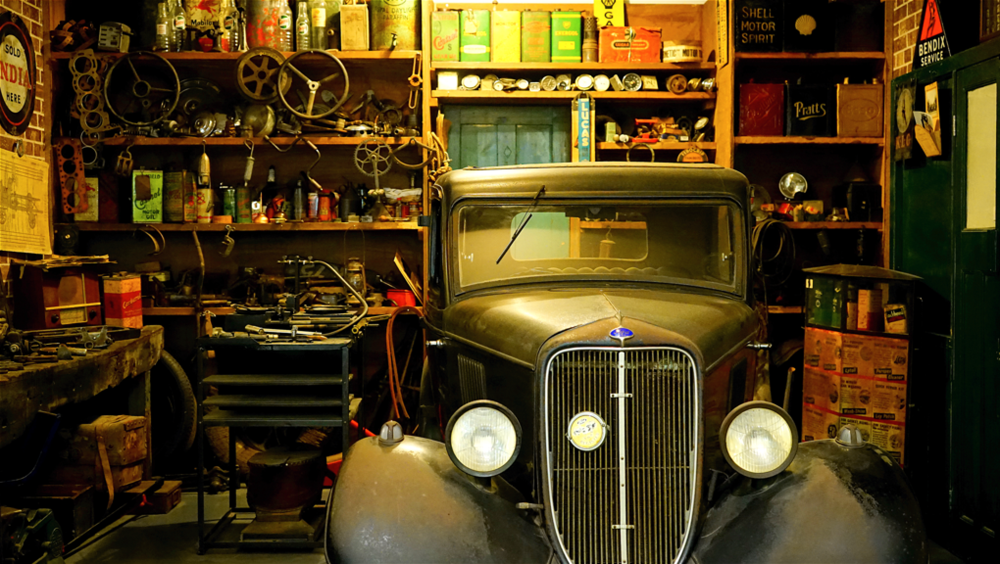

In [ ]:
display(produced_image)

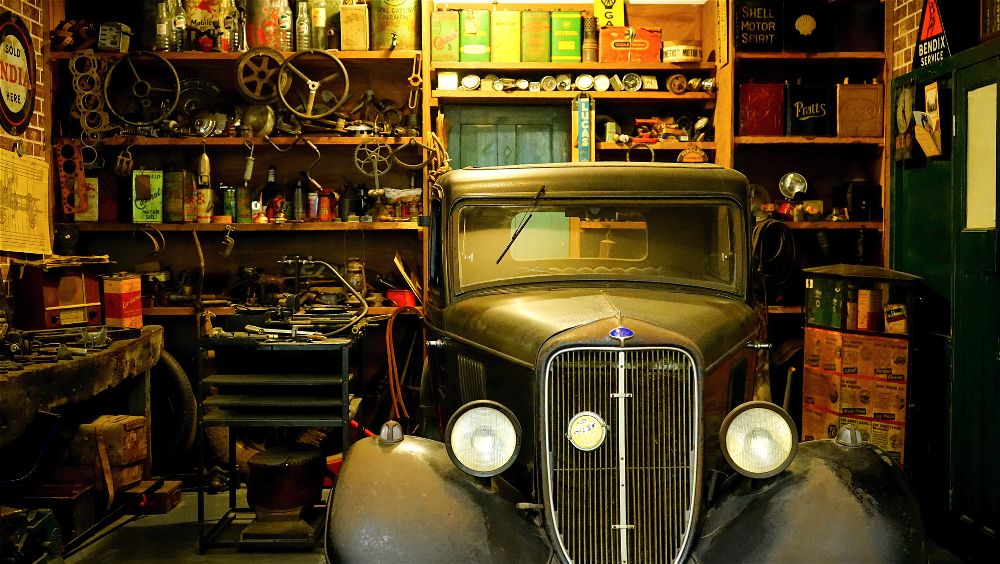

In [ ]:
display(target_image)

Linear interpolation results : SSIM and PSNR

In [ ]:
for i in data_test:
  # Gets the 2k image
  target_image = torchvision.transforms.ToPILImage()(i[1])
  # Rescales the target image to 1K to suit our experiment
  target_image.resize((int(target_image.size[0]/2), int(target_image.size[1]/2)))

  # Rescales the input image using nearest neighbour
  produced_image = torchvision.transforms.ToPILImage()(i[0]).resize((target_image.size), 1)
  _ssim = SSIM(win_size=11, win_sigma=1.5, data_range=1)(torchvision.transforms.ToTensor()(produced_image).unsqueeze(0), torchvision.transforms.ToTensor()(target_image).unsqueeze(0))
  _psrn = peak_signal_noise_ratio(cv2.cvtColor(np.array(target_image), cv2.COLOR_RGB2BGR), cv2.cvtColor(np.array(produced_image), cv2.COLOR_RGB2BGR))
  print(f'{_ssim} - {_psrn}')

0.32402801513671875 - 16.538535200969143
0.6781332492828369 - 25.769663739282173
0.7053120732307434 - 19.305385854597688
0.3503311574459076 - 16.825423859704223
0.39989688992500305 - 17.447545974341274
0.6017995476722717 - 21.691193368829484
0.2296357899904251 - 16.933561873127193
0.5515270829200745 - 17.453525479584183
0.43560782074928284 - 20.68782806530912
0.4580082595348358 - 20.559418914345446
0.47859811782836914 - 22.48693124931418
0.4553106725215912 - 18.72576160214292
0.5676978826522827 - 18.272456066477282
0.6512711048126221 - 19.189303506980362
0.5309287309646606 - 17.527141267248105
0.5186697244644165 - 18.78369855177027
0.47076892852783203 - 18.846025110281936
0.5351237654685974 - 17.07099808069664
0.3876171112060547 - 18.123857751872443
0.38333842158317566 - 15.646561339199156
0.26747921109199524 - 11.82413988934049
0.45277461409568787 - 20.605589494621682
0.46503522992134094 - 16.788833515717265
0.4941434860229492 - 14.306947276184905
0.3424522876739502 - 14.6956280493271

Bicubic interpolation results : SSIM and PSNR

In [ ]:
for i in data_test:
  # Gets the 2k image
  target_image = torchvision.transforms.ToPILImage()(i[1])
  # Rescales the target image to 1K to suit our experiment
  target_image.resize((int(target_image.size[0]/2), int(target_image.size[1]/2)))

  # Rescales the input image using nearest neighbour
  produced_image = torchvision.transforms.ToPILImage()(i[0]).resize((target_image.size), 2)
  _ssim = SSIM(win_size=11, win_sigma=1.5, data_range=1)(torchvision.transforms.ToTensor()(produced_image).unsqueeze(0), torchvision.transforms.ToTensor()(target_image).unsqueeze(0))
  _psrn = peak_signal_noise_ratio(cv2.cvtColor(np.array(target_image), cv2.COLOR_RGB2BGR), cv2.cvtColor(np.array(produced_image), cv2.COLOR_RGB2BGR))
  print(f'{_ssim} - {_psrn}')

0.3461301624774933 - 16.67504303068264
0.7092418670654297 - 25.94519859751323
0.7544168829917908 - 19.422287737358012
0.37769922614097595 - 16.966893782124075
0.4222971498966217 - 17.563125195166883
0.6418947577476501 - 21.804645609833027
0.2388564795255661 - 16.9852895671719
0.5803387761116028 - 17.54260040476742
0.4644230306148529 - 20.895040438795128
0.49248814582824707 - 20.749066180665206
0.49550363421440125 - 22.654768674330533
0.4887646436691284 - 18.933384024064807
0.5999802947044373 - 18.32114432633305
0.6900556683540344 - 19.375128045653504
0.5579050183296204 - 17.64074726062551
0.557140588760376 - 18.93613781660192
0.5121983885765076 - 19.072418703800636
0.5783383846282959 - 17.148608460321434
0.4104057550430298 - 18.241587625454542
0.3933441638946533 - 15.593597969504176
0.28798866271972656 - 11.969643964910688
0.4692002832889557 - 20.727333611585834
0.5050787925720215 - 16.9101113967279
0.5297055244445801 - 14.38984025471106
0.3641793727874756 - 14.806266802390384
0.447878

# Dense Neural network remake

In [ ]:
class new_DenseNN(NeuralNetwork):
    def __init__(self, nb_components):
        super().__init__()
        self.nb_components = nb_components
        learning_rate = 1e-1

        self.flatten = nn.Flatten()
        self.model = nn.Sequential(
            nn.Linear(self.nb_components * 3072, 512),
            nn.ReLU(),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, self.nb_components * 3072),
        )
        self.opt = torch.optim.SGD(self.parameters(), lr=learning_rate, momentum = .9)
        self.scheduler = torch.optim.lr_scheduler.StepLR(self.opt, step_size=10)
        self.loss_fn = nn.MSELoss()

    def build_pca(self, data):
      self.pca = PCA(self.nb_components).fit(data)

    def forward(self, x):
        x = self.flatten(x)
        return super().forward(x)
    
    def train_one_epoch(self, dataloader):
      self.train()
      for batch, (X, y) in enumerate(dataloader):
            # Compute prediction and loss

            X_sub,y_sub = applyPCAOnBatch(X,y, self.nb_components)
            pred = self(X_sub)
            y_sub = self.flatten(y_sub)
            loss = self.loss_fn(pred, y_sub)

            # Backpropagation
            self.opt.zero_grad()
            loss.backward()
            self.opt.step()


            if batch % 5 == 0:
                loss, current = loss.item(), batch * len(X)
                print(f"loss: {loss:>7f}  [{current:>5d}/{len(dataloader.dataset):>5d}]")
      self.scheduler.step()

    def test(self, dataloader):
      self.train()
      test_loss = 0;
      
      with torch.no_grad():
            for X, y in dataloader:
              X_sub,y_sub = self.applyPCAOnBatch(X,y, self.nb_components)

              pred = self(X_sub)
              y_sub = self.flatten(y_sub)
              test_loss += self.loss_fn(pred, y_sub)

      test_loss /= len(dataloader)
      print(f"Avg loss: {test_loss:>8f} \n")
      return test_loss.item()

    def applyPCAOnBatch(self, X):
      nb_batches = X.shape[0]
      X_temp = torch.zeros([nb_batches, X.shape[1]*X.shape[2],self.nb_components], dtype=X.dtype)
      for i in range(nb_batches):
        X_temp[i] = self.applyPCA(X[i])
      return X_temp

    def applyPCA(self, X):
      a,b,c = X.shape
      X = X.reshape((a*b,c))
      return torch.tensor(self.pca.transform(X))

    def infer(self, dataloader):
      self.eval()
      result = []
      for X, y in dataloader:
        X_sub = self.applyPCAOnBatch(X)

        pred = self(X_sub)
        result += [torch.tensor(self.pca.inverse_transform(pred[index].reshape(3,1024,self.nb_components))) for index in range(X_sub.shape[0])]
      return result

    def test_target(self, dataloader):
      result = []
      for X, y in dataloader:
        X_sub, y_sub, pcas = pca_test(X, y, self.nb_components)

        pred = y_sub
        result += [torch.tensor(pcas[index].inverse_transform(pred[index].reshape(3,1024,self.nb_components))) for index in range(X_sub.shape[0])]
      return result

In [ ]:
model = new_DenseNN(100)

batch_size = 4

def preprocessing_dense_input(img):
  return torchvision.transforms.ToTensor()(img.resize((102, 102)))

def preprocessing_dense_output(img):
  return torchvision.transforms.ToTensor()(img.resize((408, 408)))

data = DIV2KLoader('DIV2K_valid_HR', 'DIV2K_valid_HR', preprocessing_input=preprocessing_dense_input, preprocessing_output=preprocessing_dense_output)

data_loader = torch.utils.data.DataLoader(
       data, batch_size=batch_size, shuffle=True, num_workers=2)

model.build_pca(np.array([np.array(data[i]) for i in range(len(data))]))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  app.launch_new_instance()


ValueError: ignored

In [ ]:
np.array([np.array(data[i]) for i in range(len(data))])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  """Entry point for launching an IPython kernel.


array([[tensor([[[0.4471, 0.2235, 0.3098,  ..., 0.2863, 0.3608, 0.3294],
                 [0.2510, 0.2824, 0.3725,  ..., 0.2706, 0.4588, 0.3647],
                 [0.2549, 0.2196, 0.2549,  ..., 0.3020, 0.4941, 0.2275],
                 ...,
                 [0.5451, 0.5216, 0.4510,  ..., 0.1725, 0.2000, 0.1922],
                 [0.5725, 0.4863, 0.3882,  ..., 0.2431, 0.2078, 0.1922],
                 [0.5725, 0.5608, 0.4941,  ..., 0.2627, 0.1765, 0.1725]],

                [[0.4118, 0.2118, 0.3059,  ..., 0.2863, 0.3804, 0.3412],
                 [0.2431, 0.2706, 0.3686,  ..., 0.2745, 0.4706, 0.3843],
                 [0.2549, 0.2196, 0.2549,  ..., 0.3137, 0.5020, 0.2471],
                 ...,
                 [0.5255, 0.5059, 0.4314,  ..., 0.1765, 0.1922, 0.1922],
                 [0.5647, 0.4784, 0.3765,  ..., 0.2431, 0.2118, 0.1922],
                 [0.5686, 0.5569, 0.4667,  ..., 0.2706, 0.1843, 0.1725]],

                [[0.4235, 0.2000, 0.3098,  ..., 0.3020, 0.4196, 0.3647],
   